# INTRODUCCIÓN

In [9]:
import kagglehub

# Download latest version
path1 = kagglehub.dataset_download("raddar/tuberculosis-chest-xrays-montgomery")

print("Path to dataset files:", path1)

/opt/anaconda3/envs/actividad2_VA/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Path to dataset files: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1


# IMPORTACIÓN DE LIBRERÍAS

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# MÉTODOS

**Carga y muestra de imágenes**

In [11]:
# Función para mostrar imágenes lado a lado
# Con esta función conseguimos mostrar dos imágenes en una misma línea
# Viene muy bien para compararlas antes y después de aplicar los filtros

def show_images(images, titles, cmap='gray'):
    plt.figure(figsize=(15, 5))
    for i, image in enumerate(images):
        plt.subplot(1, len(images), i + 1)
        plt.imshow(image, cmap=cmap)
        plt.title(titles[i])
        plt.axis('off')
    plt.show()

In [12]:
# Cargar imagen desde una ruta local
# Indispensable para todas nuestras funcionalidades

def load_image(filepath):
    image = cv2.imread(filepath, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise ValueError("No se pudo cargar la imagen. Verifica la ruta.")
    return image

**Filtros espaciales**

In [13]:
def gaussian_blur(image, kernel_size=(5, 5)):
    """
    Aplica un filtro Gaussiano para suavizar la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel para el filtro Gaussiano (default: (5, 5)).

    Returns:
        numpy.ndarray: Imagen suavizada.
    """
    return cv2.GaussianBlur(image, kernel_size, 0)

In [14]:
def canny_edge_detection(imagen):
    """
    Aplica el filtro Canny para detección de bordes.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        threshold1 (int): Umbral inferior para la detección de bordes.
        threshold2 (int): Umbral superior para la detección de bordes.

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Asegurar que la imagen está en el formato correcto
    if imagen.dtype != np.uint8:
        imagen = np.uint8(cv2.normalize(imagen, None, 0, 255, cv2.NORM_MINMAX))

    # 1. Preprocesamiento
    # Reducción de ruido con filtro bilateral
    imagen_filtrada = cv2.bilateralFilter(imagen, d=9, sigmaColor=75, sigmaSpace=75)

    # 2. Mejora de contraste
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    imagen_mejorada = clahe.apply(imagen_filtrada)

    # 3. Detección de bordes
    bordes = cv2.Canny(imagen_mejorada, threshold1=20, threshold2=40)

    # 4. Post-procesamiento
    kernel = np.ones((3,3), np.uint8)
    bordes_dilatados = cv2.dilate(bordes, kernel, iterations=1)
    bordes_finales = cv2.erode(bordes_dilatados, kernel, iterations=1)

    return bordes_finales

In [15]:
def sobel_edge_detection(image, direction='combined'):
    """
    Aplica el filtro Sobel para detección de bordes.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        direction (str): Dirección del gradiente ('x', 'y', o 'combined').

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Asegurarse de que la imagen está en float32
    image = np.float32(image)

    # Aplicar Sobel
    sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=3)

    if direction == 'x':
        gradient = np.abs(sobel_x)
    elif direction == 'y':
        gradient = np.abs(sobel_y)
    else:
        gradient = np.sqrt(sobel_x**2 + sobel_y**2)

    # Normalizar a rango 0-255
    gradient = np.uint8(np.clip(gradient, 0, 255))

    # Mejorar el contraste
    gradient = cv2.equalizeHist(gradient)

    return gradient

**Operaciones morfológicas**

In [16]:
def morphological_dilation(image, kernel_size=(3, 3), iterations=1):
    """
    Realiza la operación de dilatación en la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel estructural (default: (3, 3)).
        iterations (int): Número de iteraciones de dilatación (default: 1).

    Returns:
        numpy.ndarray: Imagen dilatada.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    return cv2.dilate(image, kernel, iterations=iterations)

In [17]:
def morphological_erosion(image, kernel_size=(3, 3), iterations=1):
    """
    Realiza la operación de erosión en la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel estructural (default: (3, 3)).
        iterations (int): Número de iteraciones de erosión (default: 1).

    Returns:
        numpy.ndarray: Imagen erosionada.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    return cv2.erode(image, kernel, iterations=iterations)

In [18]:
def morphological_opening(image, kernel_size=(3, 3)):
    """
    Realiza la operación de apertura en la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel estructural (default: (3, 3)).

    Returns:
        numpy.ndarray: Imagen procesada con apertura.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

In [19]:
def morphological_closing(image, kernel_size=(3, 3)):
    """
    Realiza la operación de cierre en la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel estructural (default: (3, 3)).

    Returns:
        numpy.ndarray: Imagen procesada con cierre.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    return cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)

**Pipeline de ejecución**

Se propone un pipeline de ejecución con el cual se aplicarán todos los filtros y operaciones declarados anteriormente, esto es sólo una prueba, ya que puede no funcionar correctamente aplicando todos a la vez. Por ahora, están todos aplicados, pero para ciertos casos convendrá el uso sólo de unos determinados filtros o quizás unos parámetros diferentes para cada caso, todo dependerá de la función de origen. Se puede también usar este método como partida para un método que vaya aplicando filtros poco a poco o similar. También, esta función también puede funcionar a futuro para hacer una "hiperparametrización" de los valores que se aplican en cada uno de los filtros, para determinar cuáles son los mejores parámetros para obtener los mejores resultados para una imagen de entrada.

In [20]:
def process_image(filepath):
    """
    Ejecuta el pipeline completo de procesamiento de la imagen.

    Args:
        filepath (str): Ruta de la imagen a procesar.

    Workflow:
        - Carga la imagen.
        - Aplica filtros espaciales (suavizado, Canny, Sobel).
        - Aplica operaciones morfológicas (dilatación, erosión, apertura, cierre).
        - Muestra los resultados.
    """
    # Cargar imagen
    image = load_image(filepath)
    show_images([image], ["Imagen Original"])

    # Filtros Espaciales
    blurred = gaussian_blur(image)
    canny = canny_edge_detection(image)
    sobel_combined = sobel_edge_detection(image)

    show_images([blurred, canny, sobel_combined],
                ["Suavizado Gaussiano", "Bordes (Canny)", "Bordes (Sobel Combined)"])

    # Operaciones Morfológicas sobre imagen blurred
    dilated = morphological_dilation(blurred)
    eroded = morphological_erosion(blurred)
    opened = morphological_opening(blurred)
    closed = morphological_closing(blurred)

    show_images([dilated, eroded, opened, closed],
                ["Dilatación blurred", "Erosión blurred", "Apertura blurred", "Cierre blurred"])

    # Operaciones Morfológicas sobre imagen canny
    dilated = morphological_dilation(canny)
    eroded = morphological_erosion(canny)
    opened = morphological_opening(canny)
    closed = morphological_closing(canny)

    show_images([dilated, eroded, opened, closed],
                ["Dilatación canny", "Erosión canny", "Apertura canny", "Cierre canny"])

    # Operaciones Morfológicas sobre imagen sobel_combined
    dilated = morphological_dilation(sobel_combined)
    eroded = morphological_erosion(sobel_combined)
    opened = morphological_opening(sobel_combined)
    closed = morphological_closing(sobel_combined)

    show_images([dilated, eroded, opened, closed],
                ["Dilatación sobel", "Erosión sobel", "Apertura sobel", "Cierre sobel"])

<h1>SELECCIÓN DE IMÁGENES ALEATORIAS</h1>
<p> Con esta función se seleccionan aleatoriamente imágenes de un directorio, en este caso, el directorio de imágenes del dataset de tuberculosis.</p>

In [21]:
import os
import random

def select_random_images(directory, num_images):
    """
    Selecciona aleatoriamente un número de imágenes desde un directorio.

    Args:
        directory (str): Ruta del directorio que contiene las imágenes.
        num_images (int): Número de imágenes a seleccionar.

    Returns:
        list: Lista de rutas de las imágenes seleccionadas.
    """
    # Verificar si el directorio existe
    if not os.path.exists(directory):
        print("El directorio no existe.")
        return []

    # Obtener la lista de archivos en el directorio
    all_files = os.listdir(directory)
    print("Archivos en el directorio:", all_files)  # Imprimir archivos para depuración

    # Filtrar solo los archivos que son imágenes (por ejemplo, .jpg, .png)
    image_files = [f for f in all_files if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
    print("Archivos de imagen:", image_files)  # Imprimir imágenes para depuración

    # Seleccionar aleatoriamente las imágenes
    if len(image_files) == 0:
        print("No se encontraron imágenes en el directorio.")
        return []

    selected_images = random.sample(image_files, min(num_images, len(image_files)))

    # Devolver las rutas completas de las imágenes seleccionadas
    return [os.path.join(directory, img) for img in selected_images]

In [22]:
def select_last_images(directory, num_images=1):
    """
    Selecciona las últimas imágenes de un directorio, ordenadas por nombre de archivo.

    Args:
        directory (str): Ruta del directorio que contiene las imágenes.
        num_images (int): Número de imágenes a seleccionar (default: 1).

    Returns:
        str or list: Ruta de la última imagen o lista de rutas de las últimas imágenes.
    """
    import os
    import re

    if not os.path.exists(directory):
        print("El directorio no existe.")
        return None

    image_files = [f for f in os.listdir(directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if not image_files:
        print("No se encontraron imágenes en el directorio.")
        return None

    # Extraer el número de imagen del nombre de archivo usando expresiones regulares
    def extract_image_number(filename):
        match = re.search(r"_(\d+)_", filename)
        if match:
            return int(match.group(1))
        return -1  # Valor por defecto si no se encuentra el número

    # Ordenar los archivos por el número de imagen
    image_files.sort(key=extract_image_number, reverse=True)

    selected_images = image_files[:num_images]

    # Devolver las rutas completas de las imágenes seleccionadas
    selected_image_paths = [os.path.join(directory, img) for img in selected_images]

    return selected_image_paths

In [23]:
import os
import random
import re

def select_random_image_from_last_ten(directory):
    """
    Selecciona una imagen aleatoria de entre las últimas 10 imágenes de un directorio.

    Args:
        directory (str): Ruta del directorio que contiene las imágenes.

    Returns:
        str or None: Ruta de la imagen seleccionada o None si no se encuentra ninguna imagen.
    """

    if not os.path.exists(directory):
        print("El directorio no existe.")
        return None

    image_files = [f for f in os.listdir(directory) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if not image_files:
        print("No se encontraron imágenes en el directorio.")
        return None

    # Extraer el número de imagen del nombre de archivo usando expresiones regulares
    def extract_image_number(filename):
        match = re.search(r"_(\d+)_", filename)
        if match:
            return int(match.group(1))
        return -1  # Valor por defecto si no se encuentra el número

    # Ordenar los archivos por el número de imagen
    image_files.sort(key=extract_image_number, reverse=True)

    # Seleccionar las últimas 10 imágenes o menos si hay menos de 10
    last_ten_images = image_files[:min(10, len(image_files))]

    if not last_ten_images:
        print("No hay suficientes imágenes en el directorio.")
        return None

    # Seleccionar una imagen aleatoria de las últimas 10
    selected_image = random.choice(last_ten_images)

    # Devolver la ruta completa de la imagen seleccionada
    return [os.path.join(directory, selected_image)]

In [24]:
import os

path1 = '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1'
path1 = path1 + '/images/images'

print(f"Contents of directory {path1}:")
!ls -a "{path1}"

Contents of directory /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images:
.                 MCUCXR_0047_0.png MCUCXR_0090_0.png MCUCXR_0228_1.png
..                MCUCXR_0048_0.png MCUCXR_0091_0.png MCUCXR_0243_1.png
MCUCXR_0001_0.png MCUCXR_0049_0.png MCUCXR_0092_0.png MCUCXR_0251_1.png
MCUCXR_0002_0.png MCUCXR_0051_0.png MCUCXR_0094_0.png MCUCXR_0253_1.png
MCUCXR_0003_0.png MCUCXR_0052_0.png MCUCXR_0095_0.png MCUCXR_0254_1.png
MCUCXR_0004_0.png MCUCXR_0053_0.png MCUCXR_0096_0.png MCUCXR_0255_1.png
MCUCXR_0005_0.png MCUCXR_0054_0.png MCUCXR_0097_0.png MCUCXR_0258_1.png
MCUCXR_0006_0.png MCUCXR_0055_0.png MCUCXR_0099_0.png MCUCXR_0264_1.png
MCUCXR_0008_0.png MCUCXR_0056_0.png MCUCXR_0100_0.png MCUCXR_0266_1.png
MCUCXR_0011_0.png MCUCXR_0057_0.png MCUCXR_0101_0.png MCUCXR_0275_1.png
MCUCXR_0013_0.png MCUCXR_0058_0.png MCUCXR_0102_0.png MCUCXR_0282_1.png
MCUCXR_0015_0.png MCUCXR_0059_0.png MCUCXR_0103_0.png MCUCX

/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images
['/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0393_1.png']


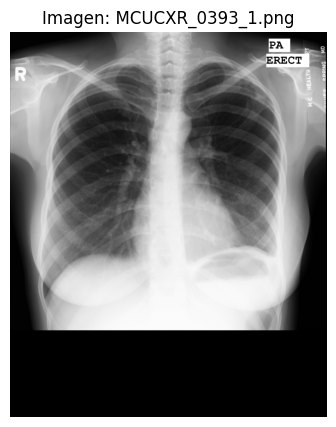

In [25]:
# Cargar y mostrar la imagen seleccionada
try:
    # Obtener una imagen aleatoria
    print(path1)
    selected_images = select_random_image_from_last_ten(path1)
    print(selected_images)

    if selected_images:
        # Cargar la imagen
        image = load_image(selected_images[0])

        # Mostrar la imagen usando nuestra función show_images
        show_images([image], [f"Imagen: {os.path.basename(selected_images[0])}"])
    else:
        print("No se pudo seleccionar ninguna imagen")

except Exception as e:
    print(f"Error: {str(e)}")

<h1>PRUEBAS INDIVIDUALES</h1>
<p> A continuación se muestran las pruebas individuales de cada filtro aplicado a una imagen aleatoria del dataset de tuberculosis.

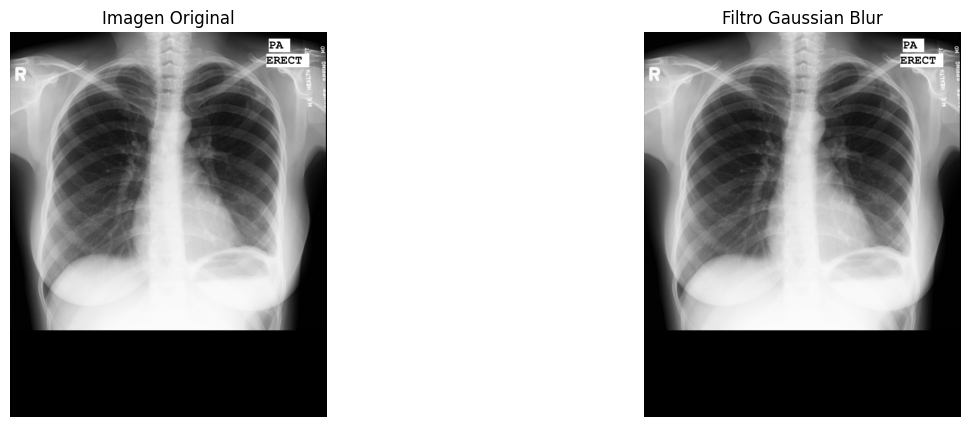

In [26]:
# Aplicar filtro Gaussian Blur y mostrar comparación
blurred_image = gaussian_blur(image)
show_images([image, blurred_image], ["Imagen Original", "Filtro Gaussian Blur"])

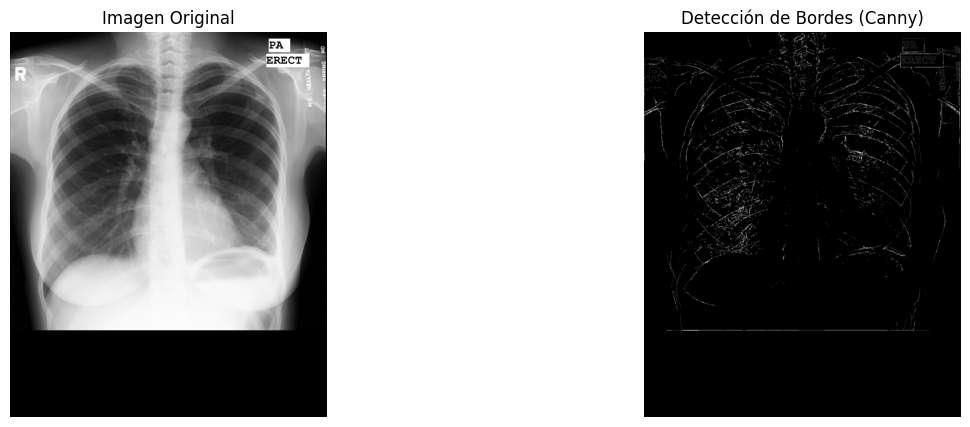

In [27]:
# Aplicar filtro Canny Edge Detection y mostrar comparación
canny_image = canny_edge_detection(image)
show_images([image, canny_image], ["Imagen Original", "Detección de Bordes (Canny)"])

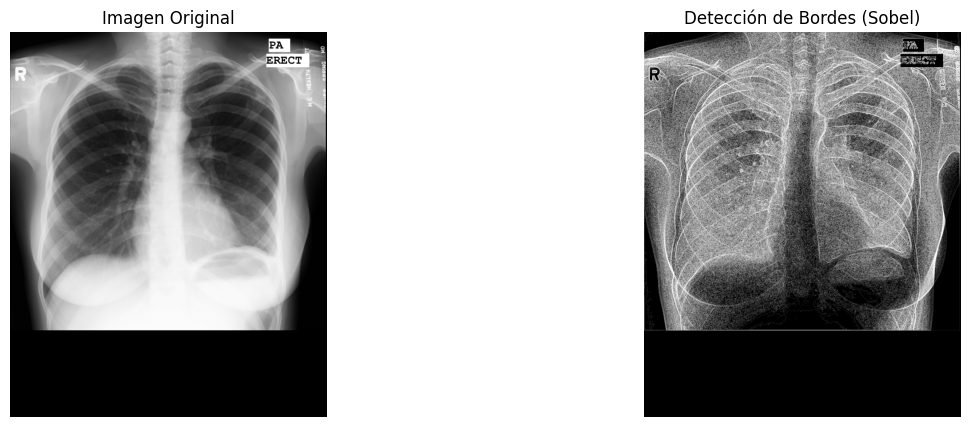

In [28]:
# Aplicar filtro Sobel Edge Detection y mostrar comparación
sobel_image = sobel_edge_detection(image)
show_images([image, sobel_image], ["Imagen Original", "Detección de Bordes (Sobel)"])

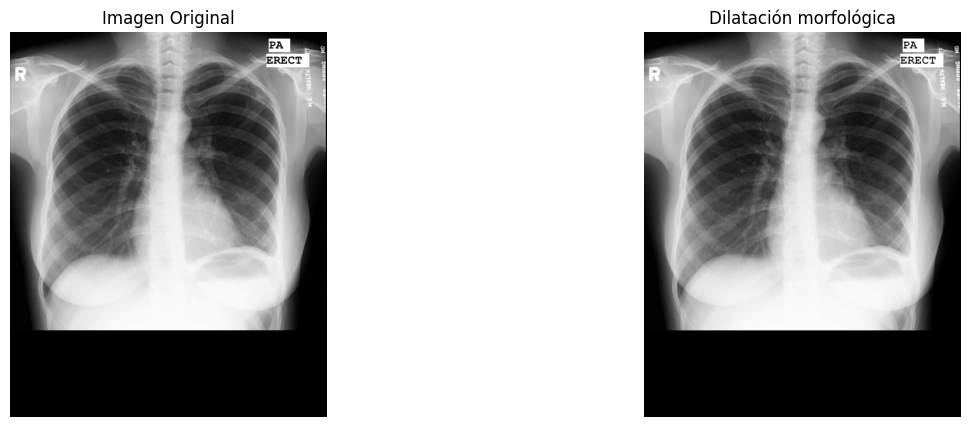

In [29]:
image_mf = morphological_dilation(image)
show_images([image, image_mf], ["Imagen Original", "Dilatación morfológica"])

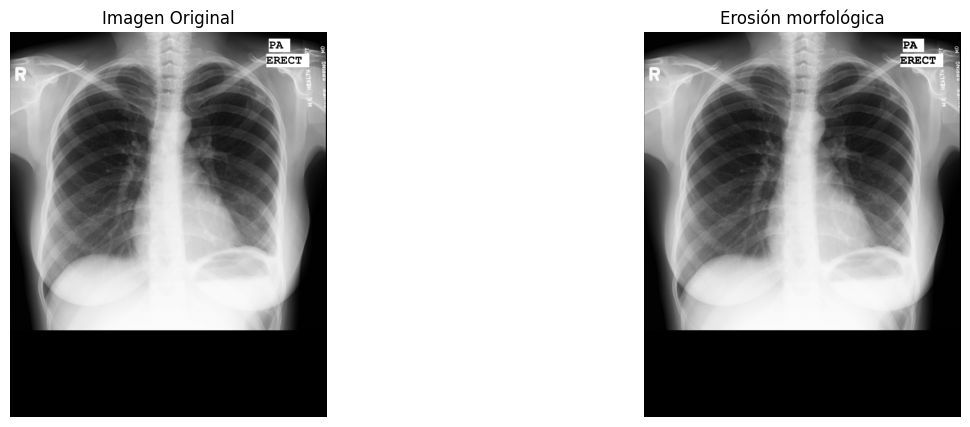

In [30]:
image_me = morphological_erosion(image)
show_images([image, image_me], ["Imagen Original", "Erosión morfológica"])

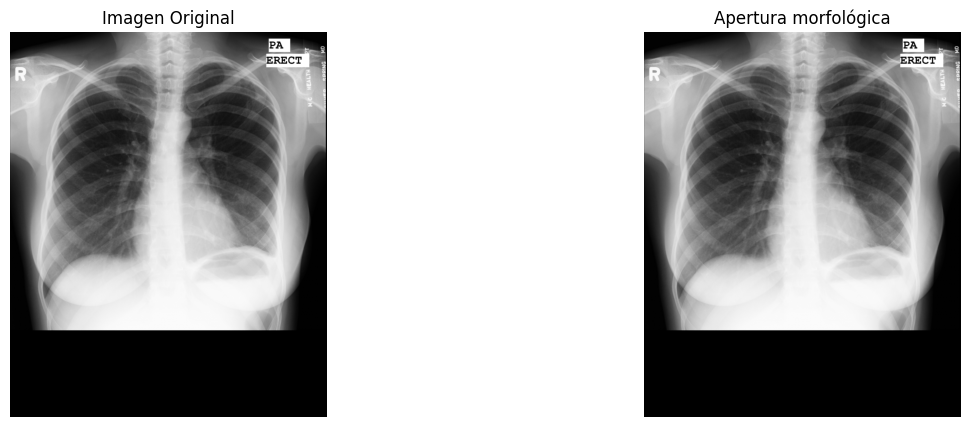

In [31]:
image_mo = morphological_opening(image)
show_images([image, image_mo], ["Imagen Original", "Apertura morfológica"])

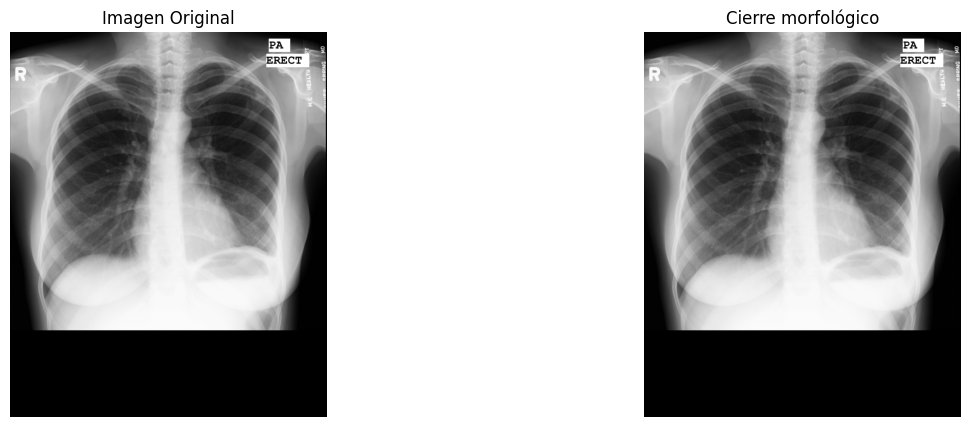

In [32]:
image_mc = morphological_closing(image)
show_images([image, image_mc], ["Imagen Original", "Cierre morfológico"])

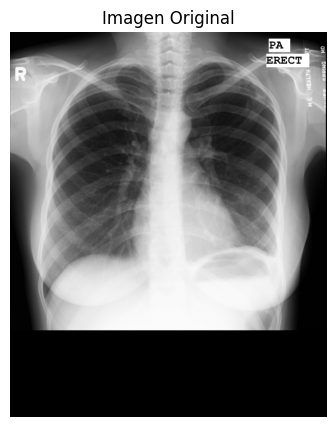

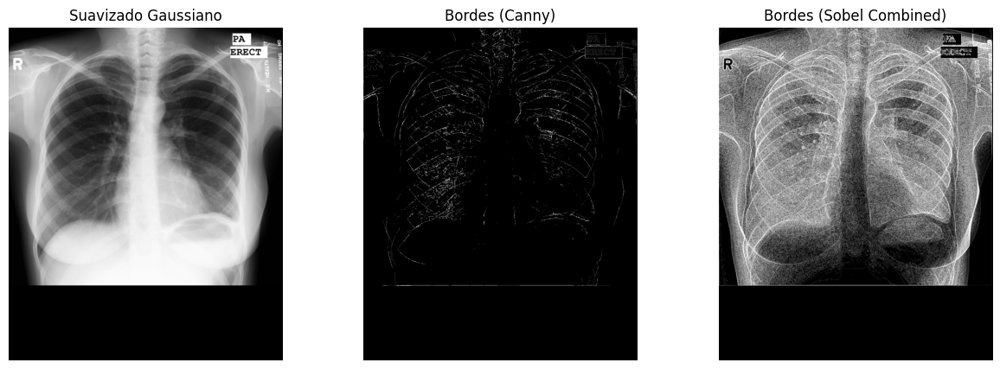

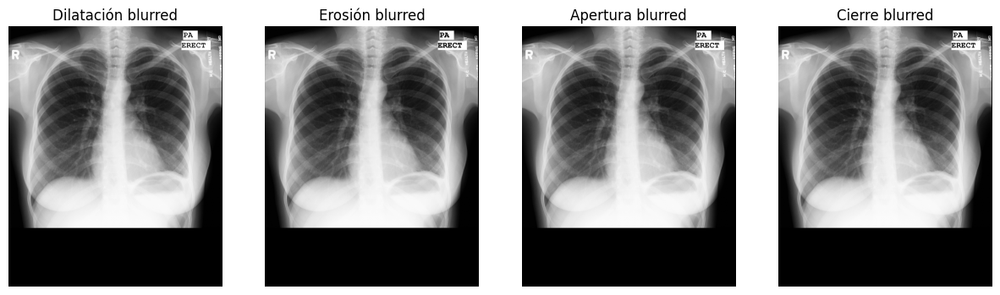

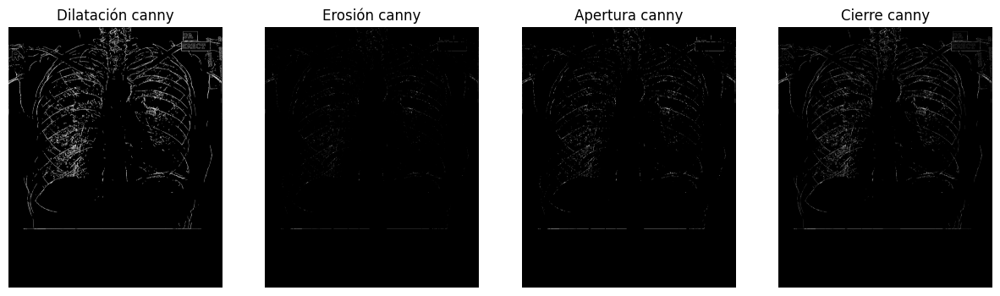

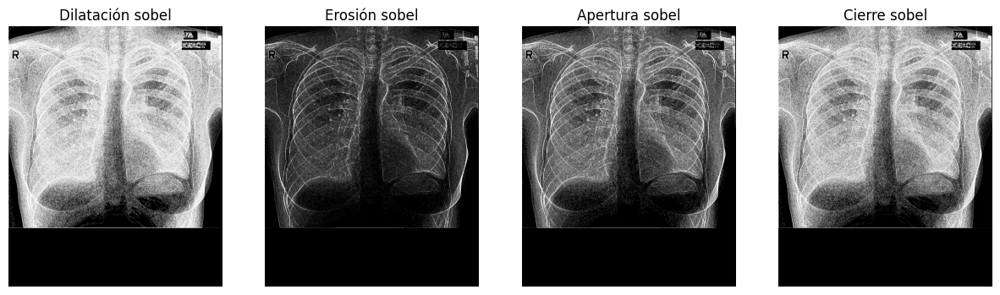

In [33]:
process_image(selected_images[0])

# GENERACIÓN DE NUEVOS FILTROS SEGÚN LA LITERATURA.


## Gaussian y mediana


In [34]:
def combined_gaussian_median_filter(image, gaussian_kernel_size=(5, 5), median_kernel_size=3):
    """
    Applies both Gaussian and Median filters to an image.

    Args:
        image (numpy.ndarray): The input image.
        gaussian_kernel_size (tuple): Kernel size for Gaussian blur (default: (5, 5)).
        median_kernel_size (int): Kernel size for median blur (default: 3).

    Returns:
        numpy.ndarray: The image after applying both filters.
    """

    # Apply Gaussian blur
    gaussian_blurred = cv2.GaussianBlur(image, gaussian_kernel_size, 0)

    # Apply median blur
    median_blurred = cv2.medianBlur(gaussian_blurred, median_kernel_size)

    return median_blurred

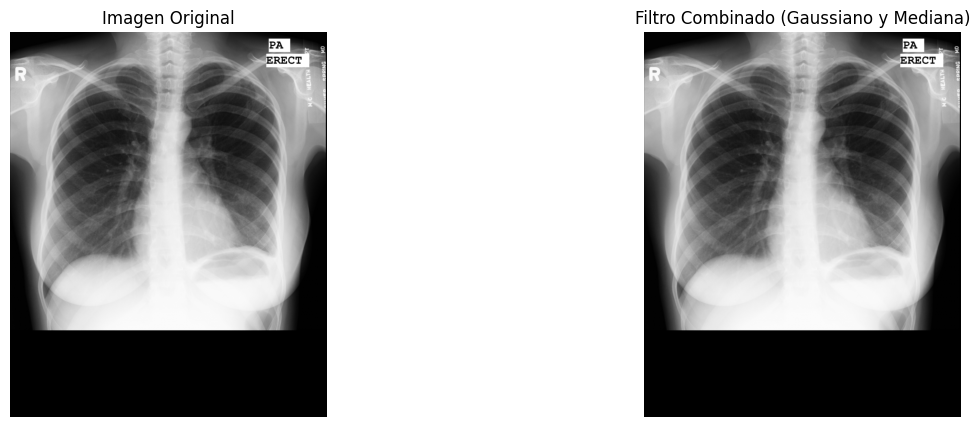

In [35]:
# Aplicar el filtro combinado y mostrar la comparación
combined_image = combined_gaussian_median_filter(image)
show_images([image, combined_image], ["Imagen Original", "Filtro Combinado (Gaussiano y Mediana)"])

In [36]:
import matplotlib.pyplot as plt

kernel_sizes = [(3, 3), (5, 5), (7, 7)]

def process_image_with_kernels(filepath, kernel_sizes):
    """
    Processes an image with different Gaussian kernels and displays results.
    """
    image = load_image(filepath)

    plt.figure(figsize=(15, 5 * (len(kernel_sizes) + 1)))

    plt.subplot(len(kernel_sizes) + 1, 1, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Imagen Original")
    plt.axis('off')

    for i, kernel_size in enumerate(kernel_sizes):
      blurred = gaussian_blur(image, kernel_size)
      plt.subplot(len(kernel_sizes) + 1, 1, i + 2)
      plt.imshow(blurred, cmap='gray')
      plt.title(f"Suavizado Gaussiano (Kernel: {kernel_size})")
      plt.axis('off')

    plt.tight_layout()
    plt.show()

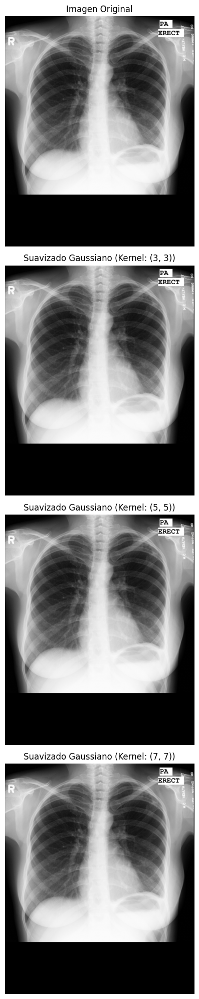

In [37]:
process_image_with_kernels(selected_images[0], kernel_sizes)

## Filtros de mejora de bordes


In [38]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def laplacian_filter(image, kernel_size=3):
    """
    Applies a Laplacian filter for edge enhancement.

    Args:
        image (numpy.ndarray): The input image.
        kernel_size (int): Size of the Laplacian kernel (default: 3). Must be odd.

    Returns:
        numpy.ndarray: The edge-enhanced image.
    """
    if kernel_size % 2 == 0:
        raise ValueError("Kernel size must be odd.")

    laplacian = cv2.Laplacian(image, cv2.CV_64F, ksize=kernel_size)
    # Normalize the result to the 0-255 range
    laplacian = np.uint8(np.absolute(laplacian))

    return laplacian

def unsharp_masking(image, kernel_size=(5, 5), sigma=1.0, amount=1.0, threshold=0):
    """
    Applies unsharp masking for edge enhancement.

    Args:
      image: Input image as a NumPy array.
      kernel_size: Size of the Gaussian blur kernel.
      sigma: Standard deviation for the Gaussian blur.
      amount: Amount of sharpening applied.
      threshold: Threshold for contrast limiting.

    Returns:
      Sharpened image as a NumPy array.
    """

    blurred = cv2.GaussianBlur(image, kernel_size, sigma)
    sharpened = float(amount + 1) * image - float(amount) * blurred
    sharpened = np.maximum(sharpened, np.zeros(sharpened.shape))
    sharpened = np.minimum(sharpened, 255 * np.ones(sharpened.shape))
    sharpened = sharpened.round().astype(np.uint8)
    return sharpened


def enhance_edges(image, method='laplacian', **kwargs):
    """
    Applies edge enhancement filters.

    Args:
        image: Input image as a NumPy array.
        method: The edge enhancement method to use ('laplacian', 'unsharp_masking').
        **kwargs: Additional keyword arguments passed to the chosen method.

    Returns:
        The edge-enhanced image as a NumPy array.
    """
    if method == 'laplacian':
      return laplacian_filter(image, **kwargs)
    elif method == 'unsharp_masking':
      return unsharp_masking(image, **kwargs)
    else:
      raise ValueError("Invalid edge enhancement method.")


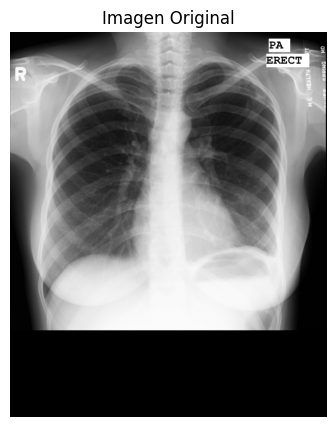

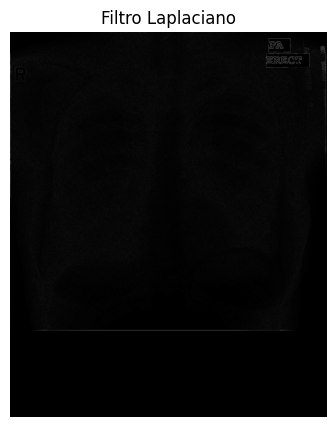

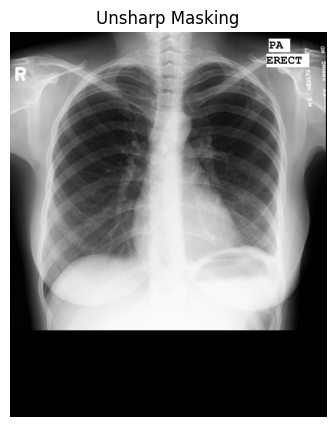

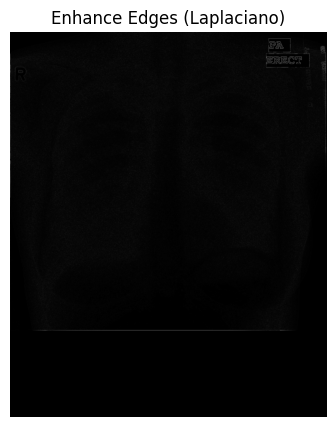

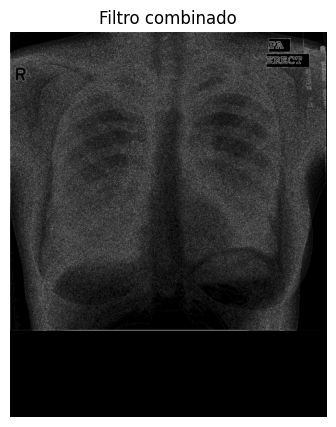

In [39]:
# Mostrar la imagen original
show_images([image], ["Imagen Original"])

# Aplicar filtro Laplaciano y mostrar resultado
laplacian_img = laplacian_filter(image)
show_images([laplacian_img], ["Filtro Laplaciano"])

# Aplicar Unsharp Masking y mostrar resultado
unsharp_img = unsharp_masking(image)
show_images([unsharp_img], ["Unsharp Masking"])

# Aplicar Enhance Edges y mostrar resultado
enhanced_img = enhance_edges(image, method='laplacian') # Puedes cambiar a 'unsharp_masking'
show_images([enhanced_img], ["Enhance Edges (Laplaciano)"])

# Aplicar los tres filtros secuencialmente y mostrar el resultado final
# Es importante liberar la memoria de las imágenes intermedias para evitar problemas.
laplacian_img = laplacian_filter(image)
unsharp_img = unsharp_masking(laplacian_img)
enhanced_img = enhance_edges(unsharp_img, method='laplacian')

show_images([enhanced_img], ["Filtro combinado"])

## Filtros top-hat y bottom-hat

In [40]:
def top_hat_filter(input_image, kernel_size=(3, 3)):
    """
    Applies the Top Hat morphological filter to an image.

    Args:
        input_image (numpy.ndarray): The input image.
        kernel_size (tuple): Size of the kernel for the morphological operation (default: (3, 3)).

    Returns:
        numpy.ndarray: The image after applying the Top Hat filter.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    tophat_img = cv2.morphologyEx(input_image, cv2.MORPH_TOPHAT, kernel)
    return tophat_img

In [41]:
def bottom_hat_filter(input_image, kernel_size=(3, 3)):
    """
    Applies the Black Hat morphological filter to an image.

    Args:
        input_image (numpy.ndarray): The input image.
        kernel_size (tuple): Size of the kernel for the morphological operation (default: (3, 3)).

    Returns:
        numpy.ndarray: The image after applying the Black Hat filter.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
    blackhat_img = cv2.morphologyEx(input_image, cv2.MORPH_BLACKHAT, kernel)
    return blackhat_img

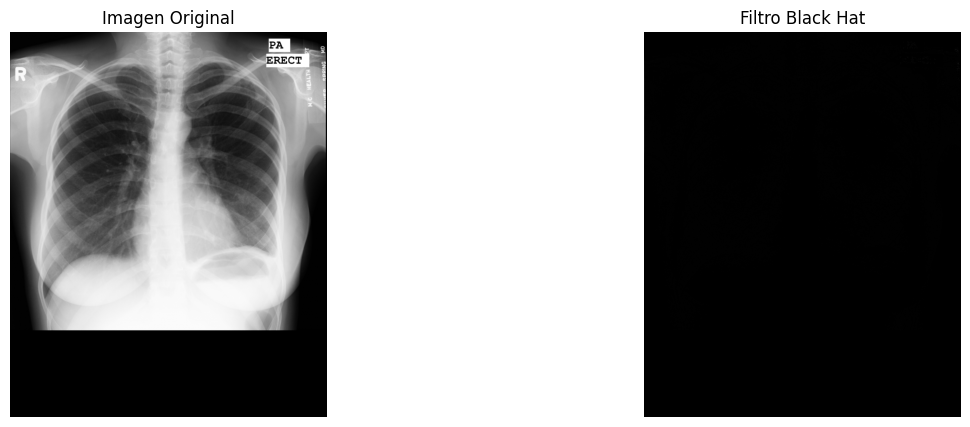

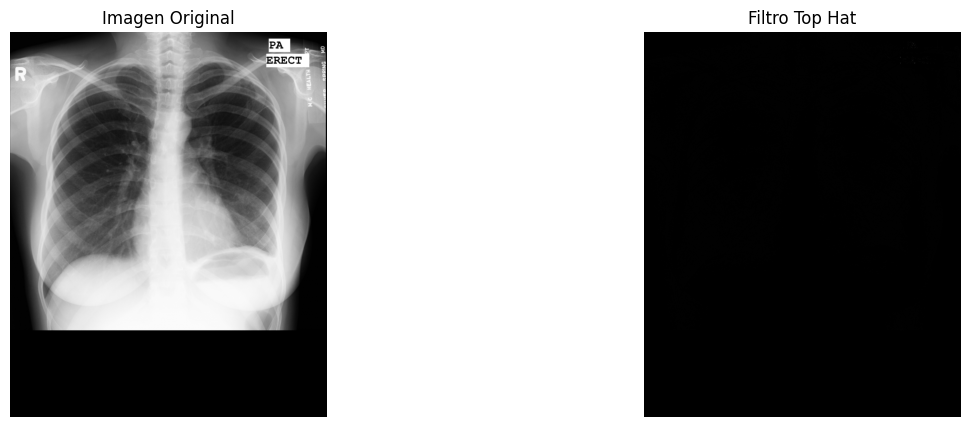

In [42]:
kernel_size = (5, 5)  # Ajusta el tamaño del kernel según sea necesario
bottomhat_img = bottom_hat_filter(image, kernel_size)
show_images([image, bottomhat_img], ["Imagen Original", "Filtro Black Hat"])

tophat_img = top_hat_filter(image, kernel_size)
show_images([image, tophat_img], ["Imagen Original", "Filtro Top Hat"])

## Sobel

In [43]:
def sobel_edge_detection(image, ksize=3):
    """
    Applies Sobel edge detection to an image.

    Args:
        image (numpy.ndarray): The input image.
        ksize (int): Size of the Sobel kernel (default: 3).

    Returns:
        numpy.ndarray: The image with Sobel edges highlighted.
    """
    # The image is already grayscale, so no need for conversion
    # gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Remove this line
    gray = image  # Use the original image directly
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
    return grad

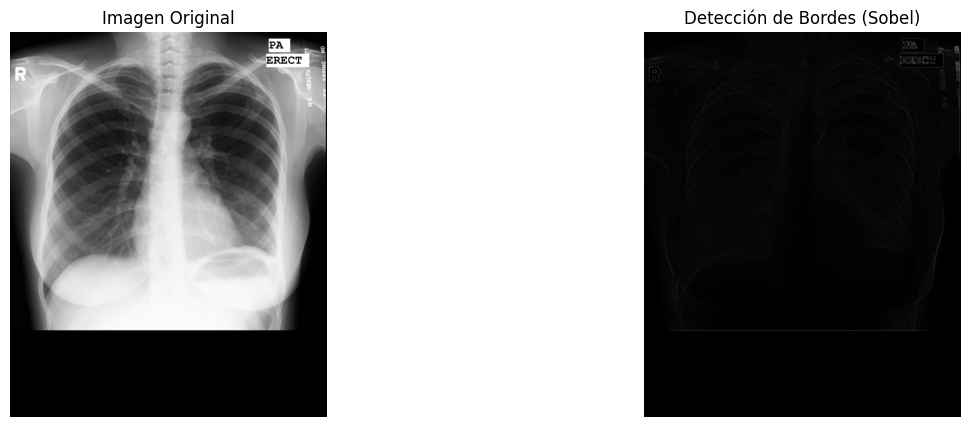

In [44]:
sobel_image = sobel_edge_detection(image)
show_images([image, sobel_image], ["Imagen Original", "Detección de Bordes (Sobel)"])

## Aplicacion de filtros en imágenes seleccionadas

In [47]:
def select_specific_images(directory, image_numbers):
    """
    Selects images with specific numbers from a directory.

    Args:
        directory (str): Path to the directory containing the images.
        image_numbers (list): List of image numbers to select.

    Returns:
        list: List of paths to the selected images.
    """
    selected_images = []
    for filename in os.listdir(directory):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            match = re.search(r"_(\d+)_", filename)
            if match:
                image_number = int(match.group(1))
                if image_number in image_numbers:
                    selected_images.append(os.path.join(directory, filename))
    return selected_images

# Example usage (replace with your actual directory and image numbers)
path1 = '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images'
image_numbers_to_select = [338, 266, 383, 367]
selected_image_paths = select_specific_images(path1, image_numbers_to_select)

print(f"Selected Images: {selected_image_paths}")

Selected Images: ['/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0383_1.png', '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0367_1.png', '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0338_1.png', '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0266_1.png']


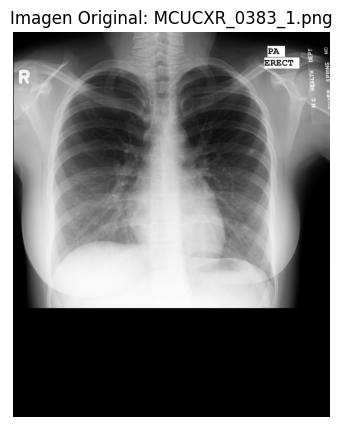

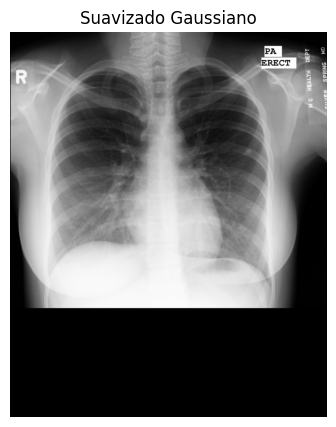

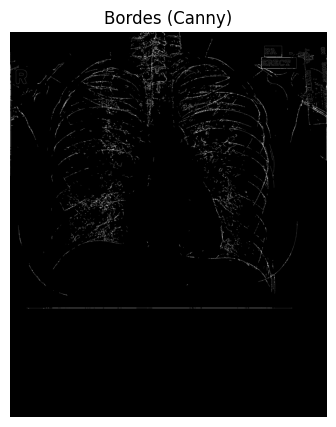

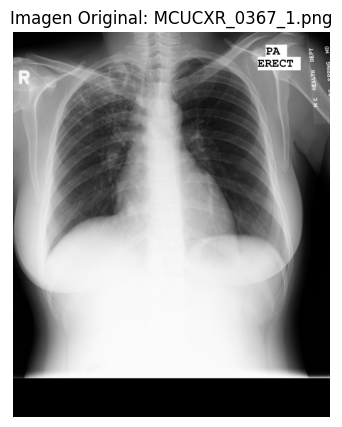

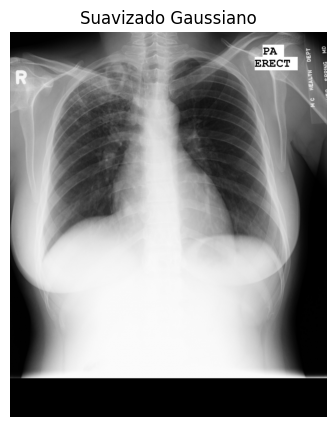

...

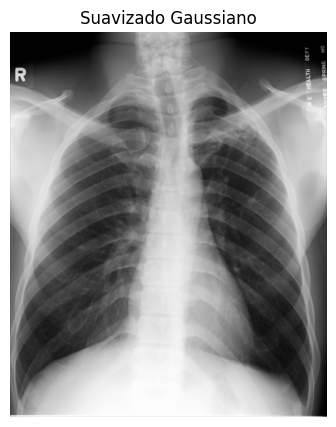

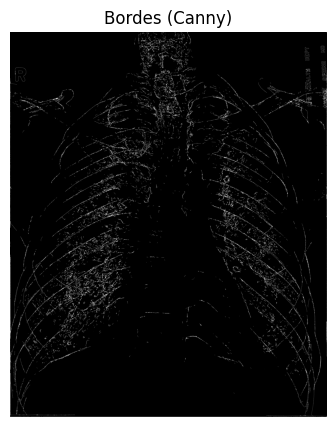

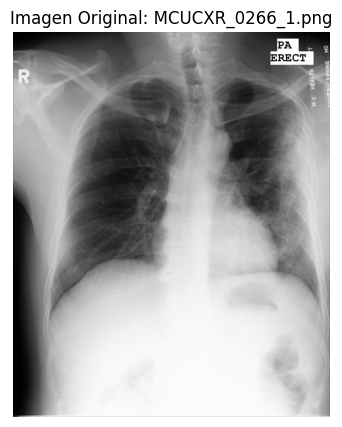

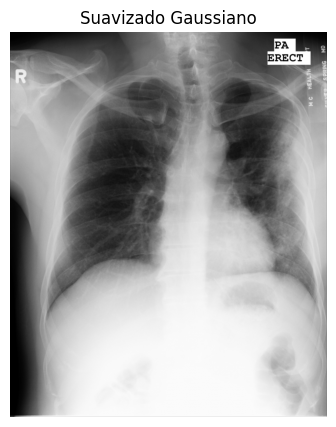

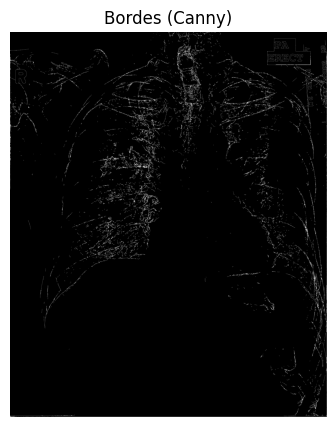

In [48]:
def apply_filters_to_selected_images(image_paths):
    """Applies filters to a list of images and displays the results."""
    for image_path in image_paths:
        try:
            # Load the image
            image = load_image(image_path)

            # Show the original image
            show_images([image], [f"Imagen Original: {os.path.basename(image_path)}"])

            # Apply and display the filters (example: Gaussian blur, Canny)
            blurred = gaussian_blur(image)
            show_images([blurred], ["Suavizado Gaussiano"])

            canny = canny_edge_detection(image)
            show_images([canny], ["Bordes (Canny)"])

            # ... apply other filters ...

        except Exception as e:
            print(f"Error processing image {image_path}: {e}")

# Example usage:
# Assuming you have a list of selected image paths called 'selected_image_paths'
apply_filters_to_selected_images(selected_image_paths)

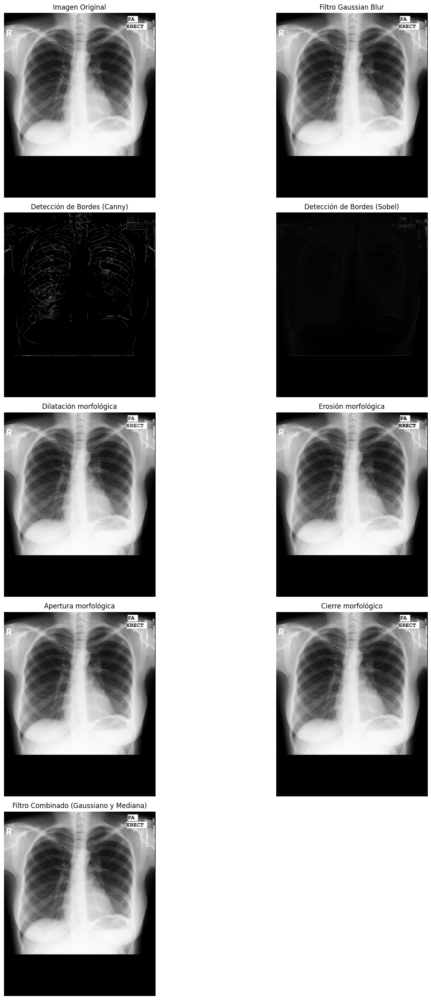

In [49]:
def show_images(images, titles, cols=2):
    """Displays a list of images in a grid layout with specified column count."""
    rows = (len(images) + cols - 1) // cols  # Calculate the number of rows
    plt.figure(figsize=(15, 5 * rows))  # Adjust figure size based on the number of rows

    for i, (image, title) in enumerate(zip(images, titles)):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(image, cmap='gray')  # Assuming grayscale images
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


# Example usage of show_images with two columns:
# Assuming you have 'image', 'blurred_image', etc. defined

# Original image in the first column
show_images([image, blurred_image, canny_image, sobel_image, image_mf, image_me, image_mo, image_mc, combined_image],
            ["Imagen Original", "Filtro Gaussian Blur", "Detección de Bordes (Canny)", "Detección de Bordes (Sobel)", "Dilatación morfológica", "Erosión morfológica", "Apertura morfológica", "Cierre morfológico", "Filtro Combinado (Gaussiano y Mediana)"], cols=2)


# ... (rest of your code, update other show_images calls similarly)


def process_image_with_kernels(filepath, kernel_sizes):
    """
    Processes an image with different Gaussian kernels and displays results in two columns.
    """
    image = load_image(filepath)

    num_images = len(kernel_sizes) + 1
    cols = 2  # Two columns
    rows = (num_images + cols - 1) // cols
    plt.figure(figsize=(15, 5 * rows))

    plt.subplot(rows, cols, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Imagen Original")
    plt.axis('off')

    for i, kernel_size in enumerate(kernel_sizes):
        blurred = gaussian_blur(image, kernel_size)
        plt.subplot(rows, cols, i + 2)
        plt.imshow(blurred, cmap='gray')
        plt.title(f"Suavizado Gaussiano (Kernel: {kernel_size})")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


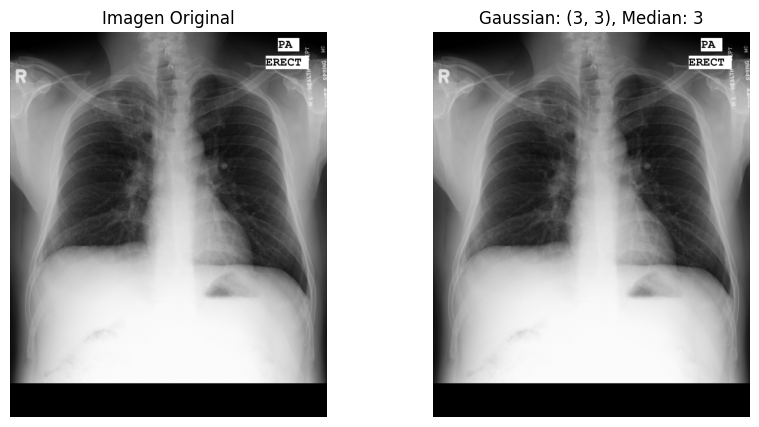

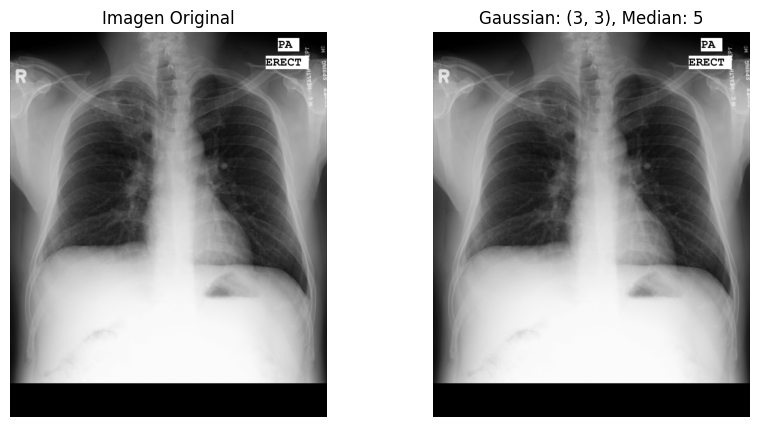

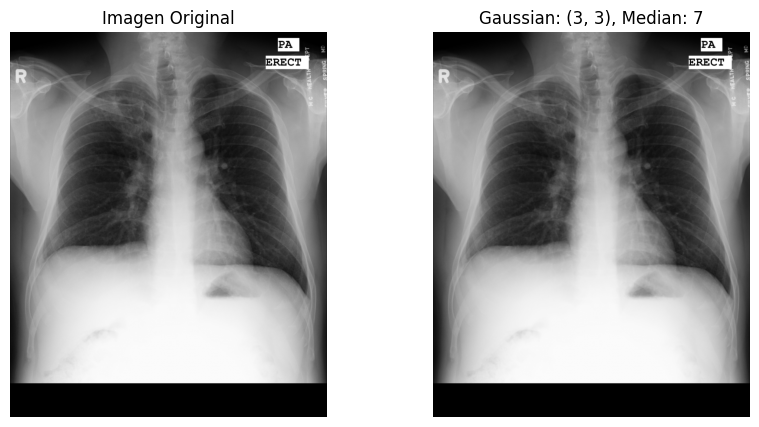

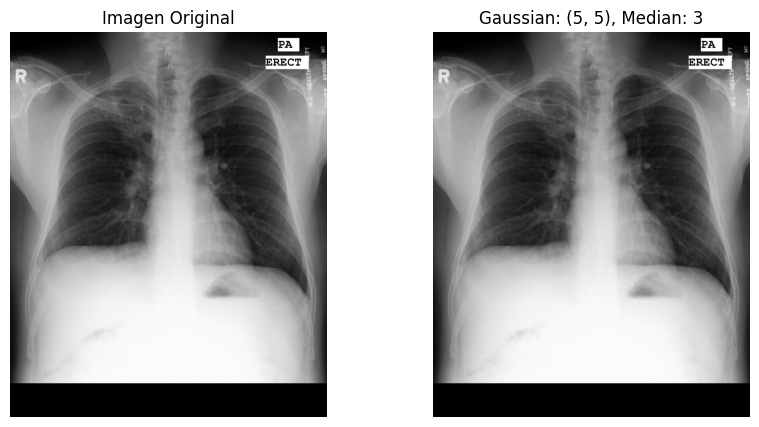

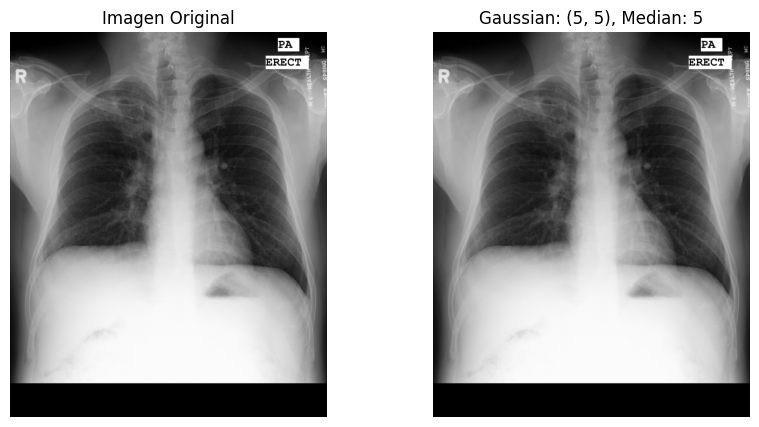

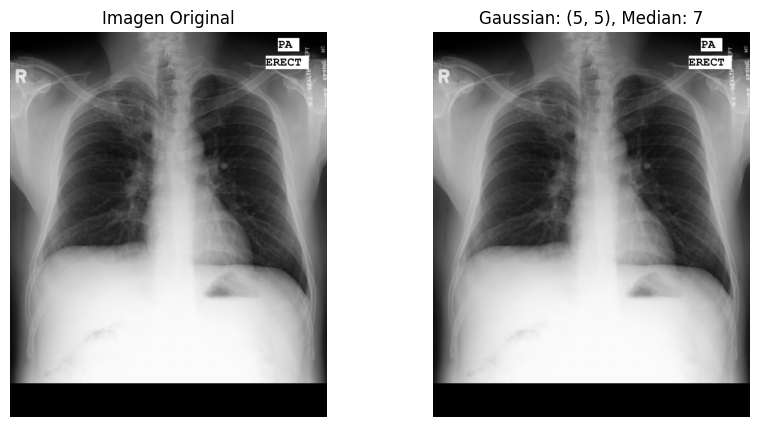

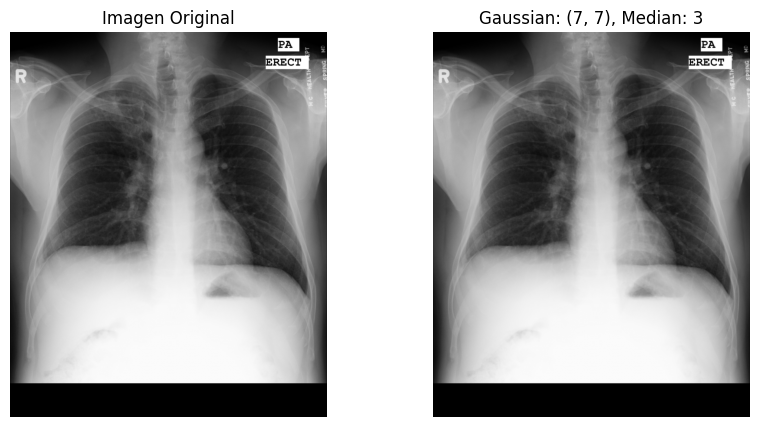

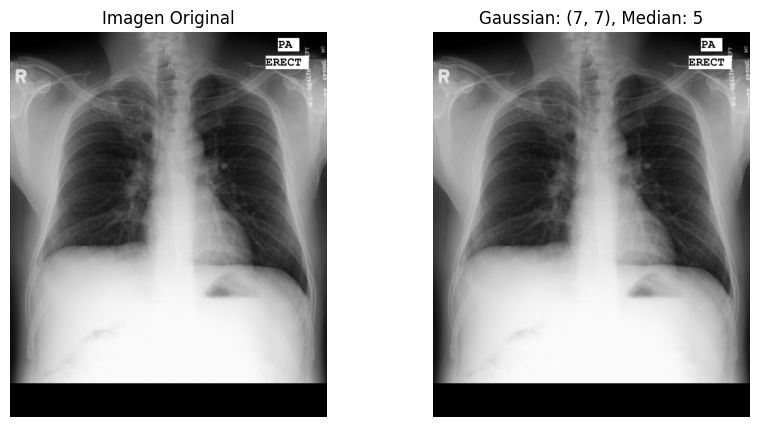

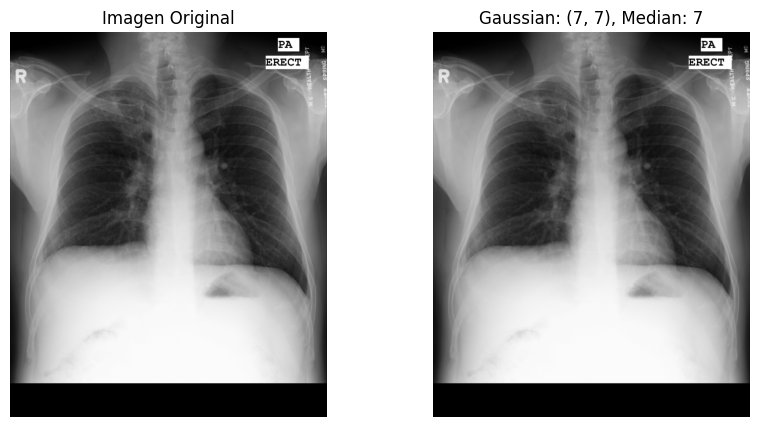

In [50]:
def combined_gaussian_median_filter(image, gaussian_kernel_size=(5, 5), median_kernel_size=3):
    """
    Aplica un filtro combinado de suavizado Gaussiano y Mediana.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        gaussian_kernel_size (tuple): Tamaño del kernel para el filtro Gaussiano (default: (5, 5)).
        median_kernel_size (int): Tamaño del kernel para el filtro Mediana (default: 3).

    Returns:
        numpy.ndarray: Imagen procesada con ambos filtros.
    """
    # Aplicar filtro Gaussiano
    gaussian_blurred = cv2.GaussianBlur(image, gaussian_kernel_size, 0)

    # Aplicar filtro Mediana
    median_blurred = cv2.medianBlur(gaussian_blurred, median_kernel_size)

    return median_blurred

def visualize_hyperparameter_search(image, gaussian_kernels, median_kernels):
    """
    Realiza la hiperparametrización del filtro combinado y visualiza los resultados.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        gaussian_kernels (list of tuple): Lista de tamaños de kernel para el filtro Gaussiano.
        median_kernels (list of int): Lista de tamaños de kernel para el filtro Mediana.
    """
    for g_kernel in gaussian_kernels:
        for m_kernel in median_kernels:
            # Aplicar filtro combinado
            result = combined_gaussian_median_filter(image, gaussian_kernel_size=g_kernel, median_kernel_size=m_kernel)
            
            # Visualizar imagen original y resultado
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(image, cmap='gray')
            plt.title("Imagen Original")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(result, cmap='gray')
            plt.title(f"Gaussian: {g_kernel}, Median: {m_kernel}")
            plt.axis('off')

            plt.show()

# Cargar la imagen de prueba
filepath = '/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0289_1.png'  # Reemplaza con la ruta de tu imagen
image = cv2.imread(filepath, cv2.IMREAD_GRAYSCALE)

# Hiperparámetros a probar
gaussian_kernels = [(3, 3), (5, 5), (7, 7)]
median_kernels = [3, 5, 7]

# Realizar búsqueda de hiperparámetros
visualize_hyperparameter_search(image, gaussian_kernels, median_kernels)


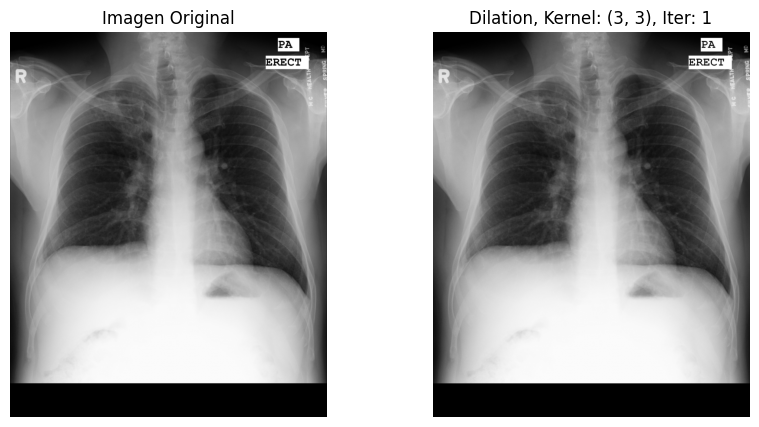

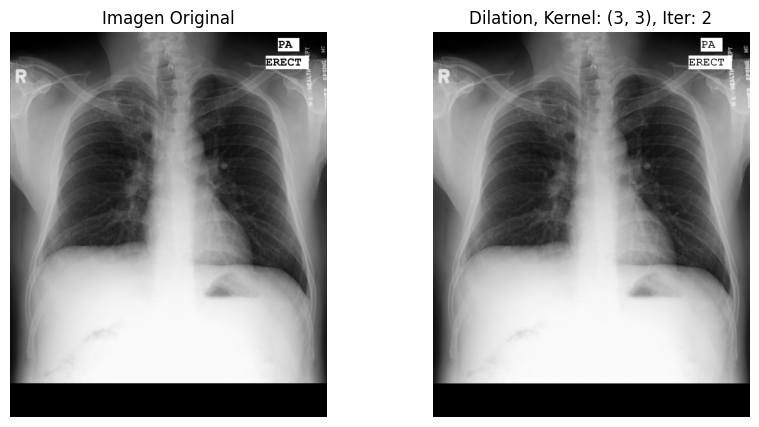

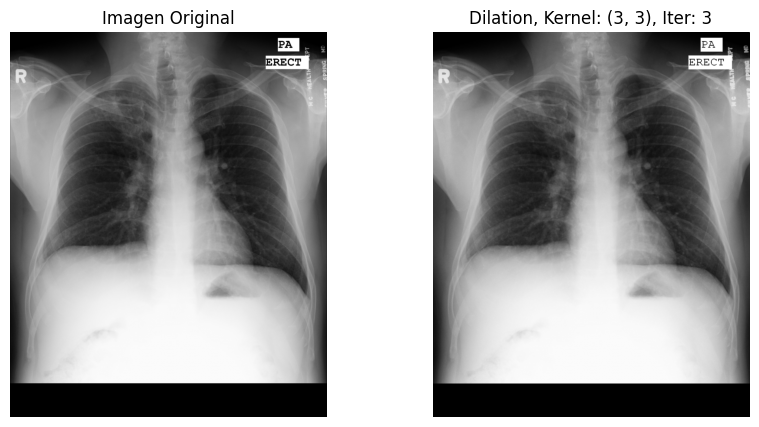

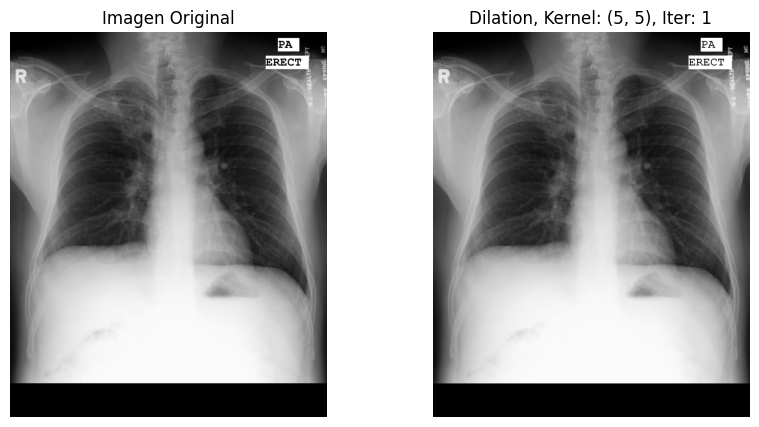

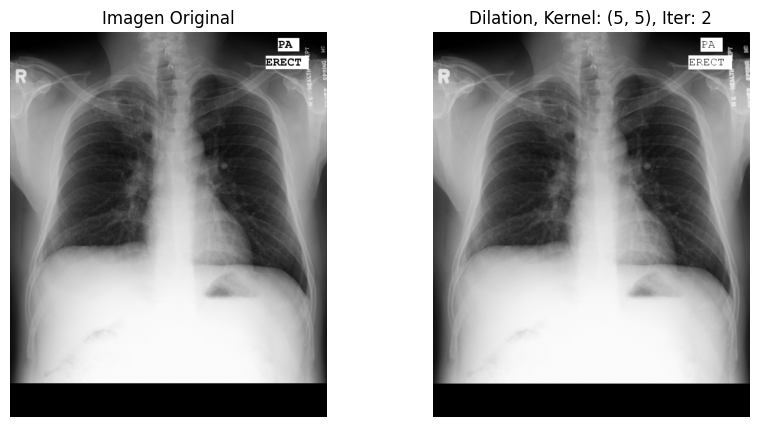

...

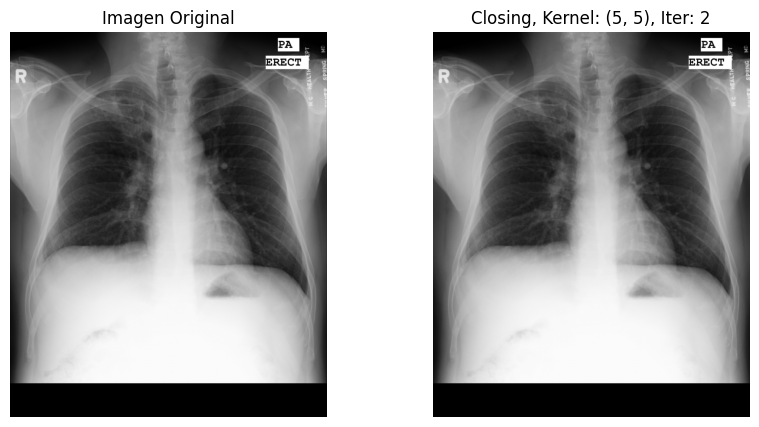

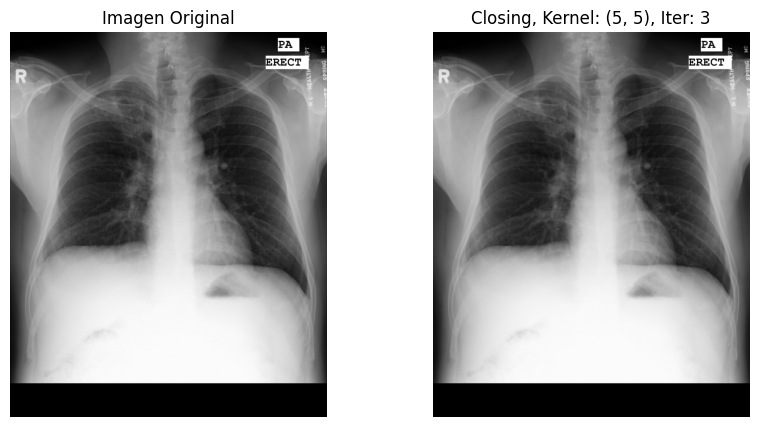

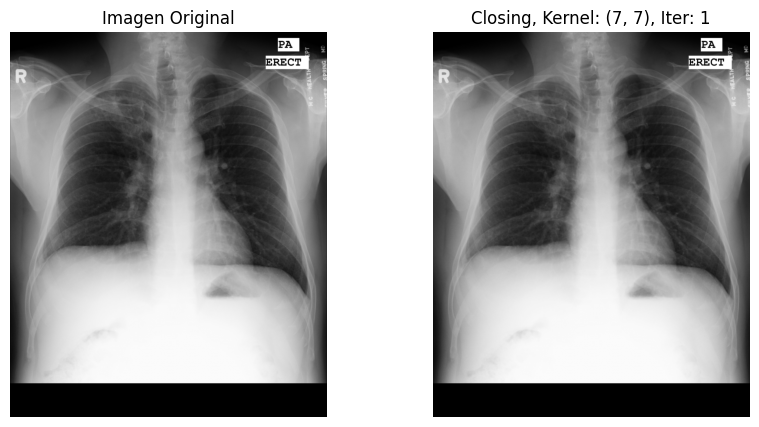

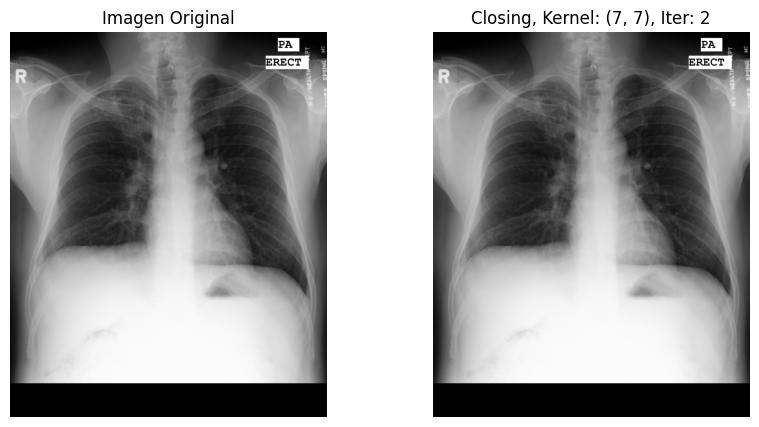

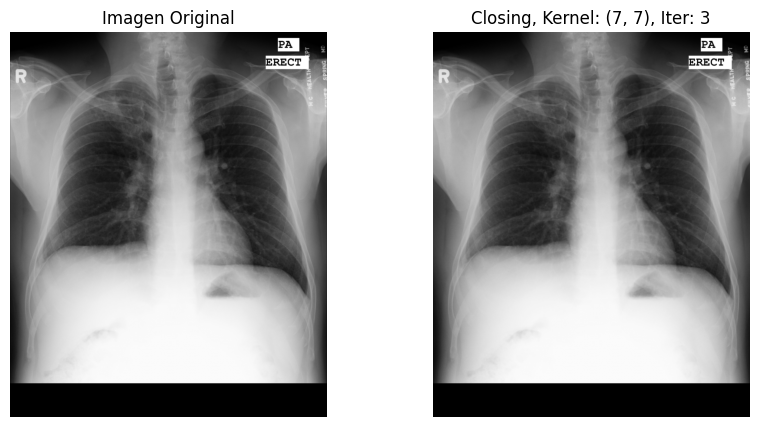

In [51]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Función para aplicar operaciones morfológicas
def morphological_operation(image, operation, kernel_size=(3, 3), iterations=1):
    """
    Aplica una operación morfológica a la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        operation (str): Operación a aplicar ('dilation', 'erosion', 'opening', 'closing').
        kernel_size (tuple): Tamaño del kernel estructural (default: (3, 3)).
        iterations (int): Número de iteraciones (default: 1).

    Returns:
        numpy.ndarray: Imagen procesada con la operación morfológica.
    """
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)

    if operation == 'dilation':
        return cv2.dilate(image, kernel, iterations=iterations)
    elif operation == 'erosion':
        return cv2.erode(image, kernel, iterations=iterations)
    elif operation == 'opening':
        return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    elif operation == 'closing':
        return cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    else:
        raise ValueError("Operación no válida. Use 'dilation', 'erosion', 'opening' o 'closing'.")

# Visualizar hiperparametrización de operaciones morfológicas
def visualize_morphological_hyperparameter_search(image, operations, kernel_sizes, iterations_list):
    """
    Realiza la hiperparametrización de operaciones morfológicas y visualiza los resultados.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        operations (list of str): Lista de operaciones morfológicas a probar.
        kernel_sizes (list of tuple): Lista de tamaños de kernel estructural.
        iterations_list (list of int): Lista de números de iteraciones a probar.
    """
    for operation in operations:
        for kernel_size in kernel_sizes:
            for iterations in iterations_list:
                # Aplicar operación morfológica
                result = morphological_operation(image, operation, kernel_size=kernel_size, iterations=iterations)

                # Visualizar imagen original y resultado
                plt.figure(figsize=(10, 5))
                plt.subplot(1, 2, 1)
                plt.imshow(image, cmap='gray')
                plt.title("Imagen Original")
                plt.axis('off')

                plt.subplot(1, 2, 2)
                plt.imshow(result, cmap='gray')
                plt.title(f"{operation.title()}, Kernel: {kernel_size}, Iter: {iterations}")
                plt.axis('off')

                plt.show()

# Cargar la imagen de prueba
image_path = "/Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0289_1.png"
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Definir los hiperparámetros a probar
operations = ['dilation', 'erosion', 'opening', 'closing']
kernel_sizes = [(3, 3), (5, 5), (7, 7)]
iterations_list = [1, 2, 3]

# Realizar búsqueda de hiperparámetros
visualize_morphological_hyperparameter_search(image, operations, kernel_sizes, iterations_list)


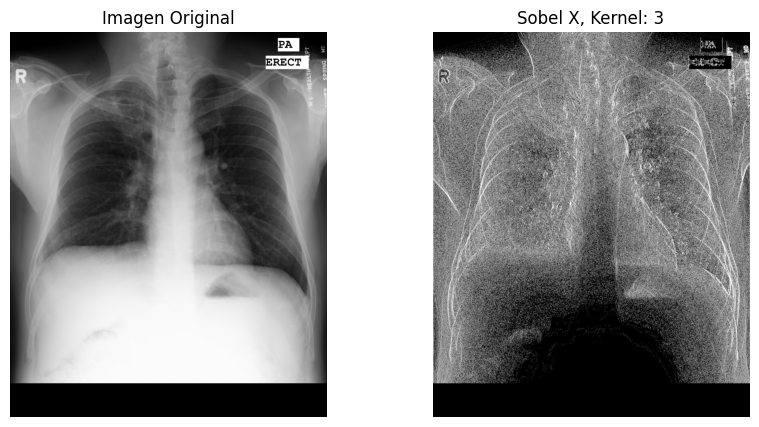

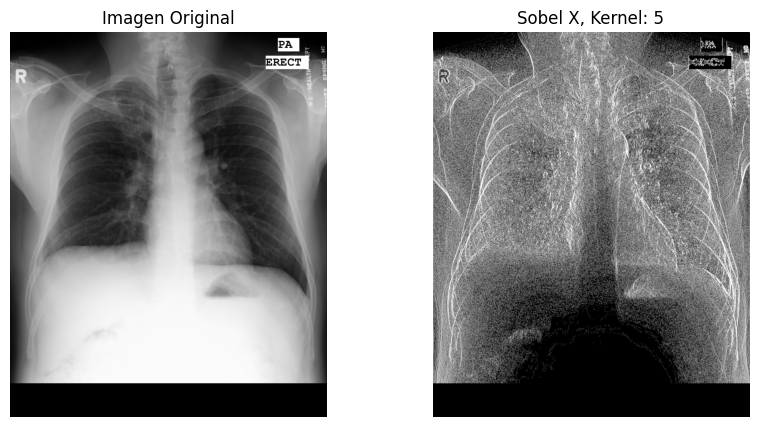

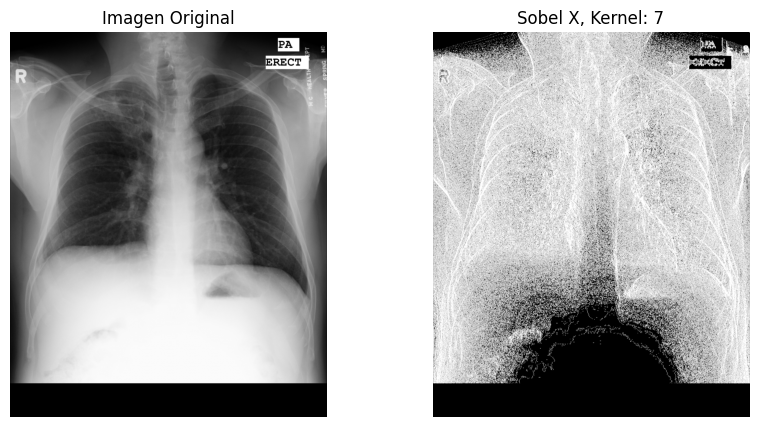

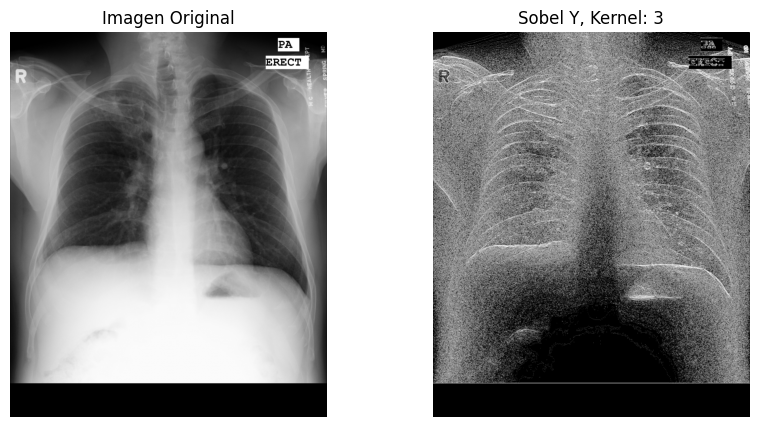

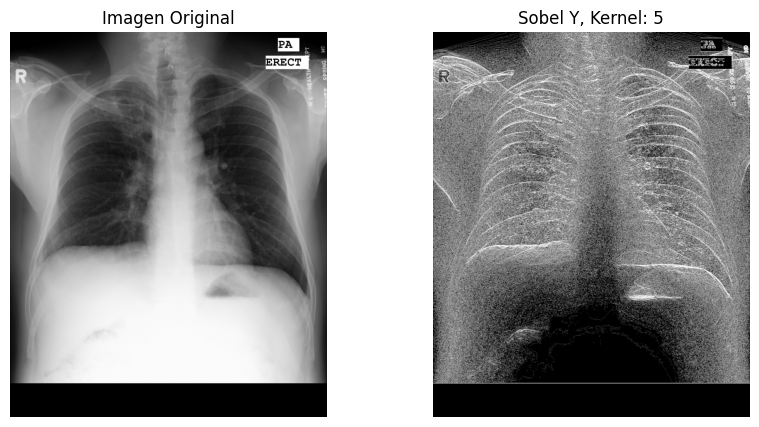

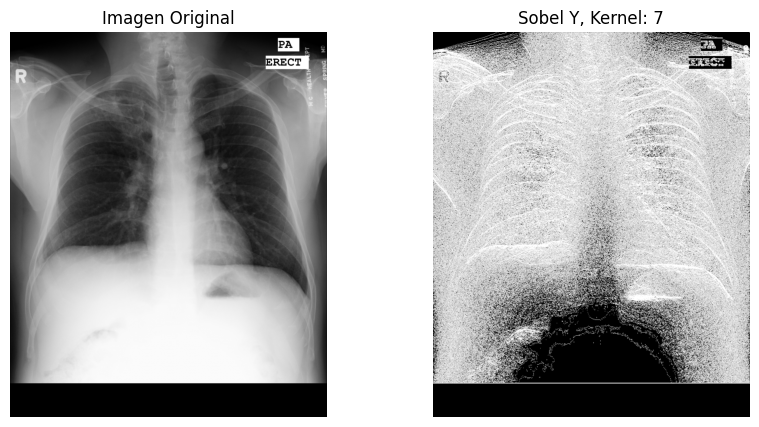

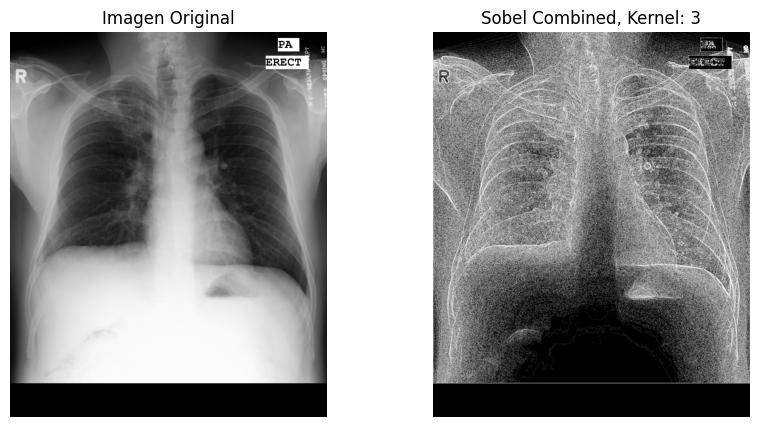

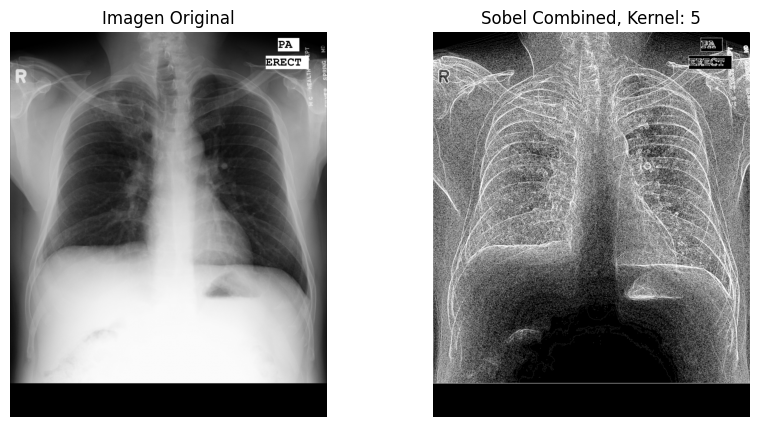

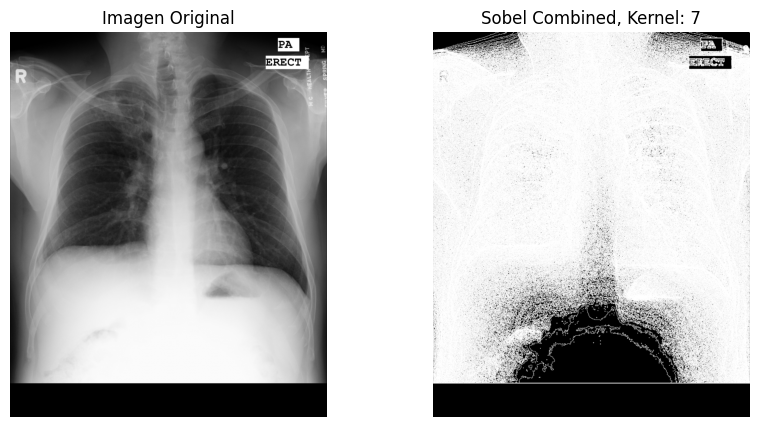

In [52]:
def sobel_edge_detection(image, direction='combined', ksize=3):
    """
    Aplica el filtro Sobel para detección de bordes con hiperparametrización.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        direction (str): Dirección del gradiente ('x', 'y', o 'combined').
        ksize (int): Tamaño del kernel Sobel (debe ser 1, 3, 5 o 7).

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Asegurarse de que la imagen está en float32
    image = np.float32(image)

    # Aplicar Sobel
    sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=ksize)
    sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=ksize)

    if direction == 'x':
        gradient = np.abs(sobel_x)
    elif direction == 'y':
        gradient = np.abs(sobel_y)
    else:
        gradient = np.sqrt(sobel_x**2 + sobel_y**2)

    # Normalizar a rango 0-255
    gradient = np.uint8(np.clip(gradient, 0, 255))

    # Mejorar el contraste
    gradient = cv2.equalizeHist(gradient)

    return gradient

# Visualizar hiperparametrización para Sobel

def visualize_sobel_hyperparameter_search(image, directions, kernel_sizes):
    """
    Realiza la hiperparametrización del filtro Sobel y visualiza los resultados.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        directions (list of str): Lista de direcciones del gradiente ('x', 'y', 'combined').
        kernel_sizes (list of int): Lista de tamaños de kernel Sobel a probar.
    """
    for direction in directions:
        for ksize in kernel_sizes:
            # Aplicar filtro Sobel
            result = sobel_edge_detection(image, direction=direction, ksize=ksize)

            # Visualizar imagen original y resultado
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(image, cmap='gray')
            plt.title("Imagen Original")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(result, cmap='gray')
            plt.title(f"Sobel {direction.title()}, Kernel: {ksize}")
            plt.axis('off')

            plt.show()

# Definir parámetros para Sobel
directions = ['x', 'y', 'combined']
kernel_sizes_sobel = [3, 5, 7]

# Realizar búsqueda de hiperparámetros para Sobel
visualize_sobel_hyperparameter_search(image, directions, kernel_sizes_sobel)


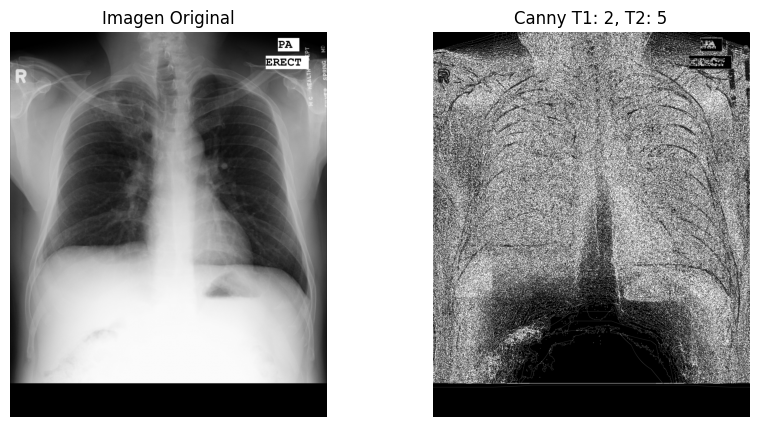

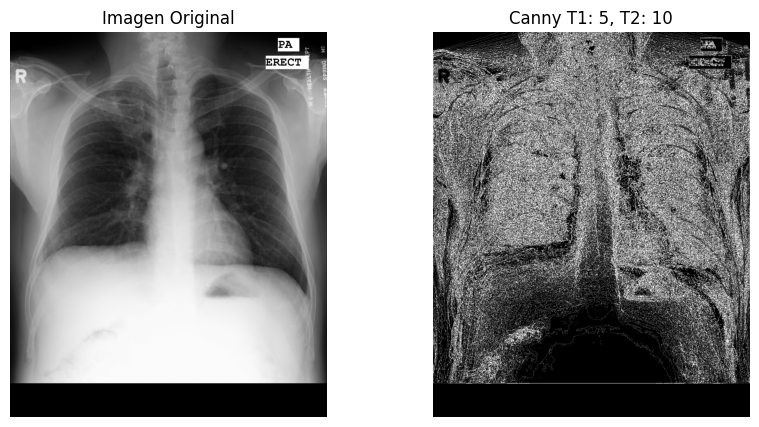

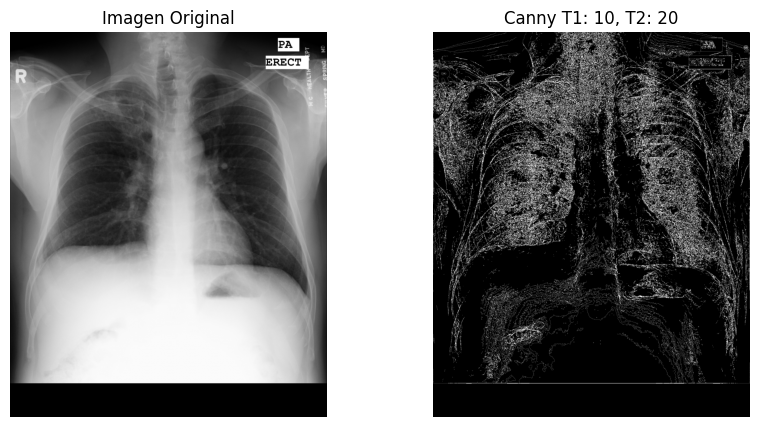

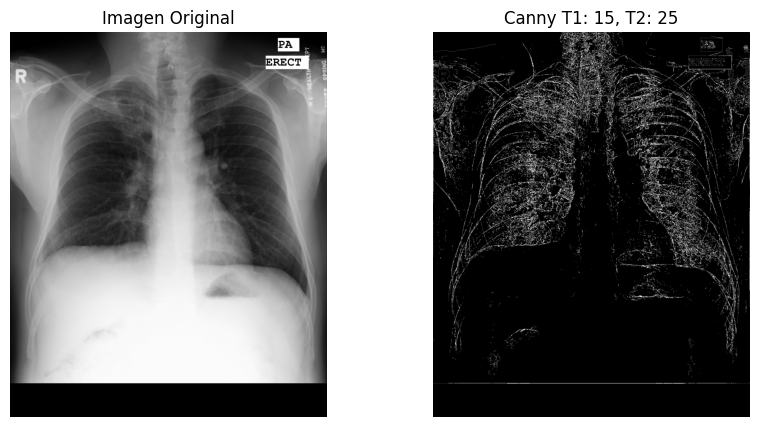

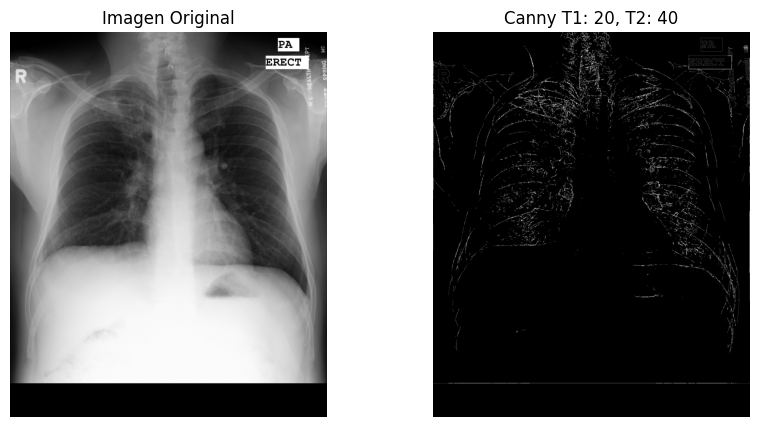

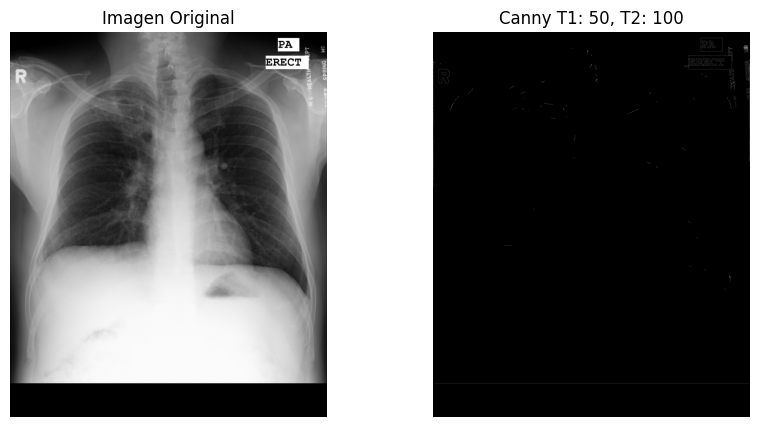

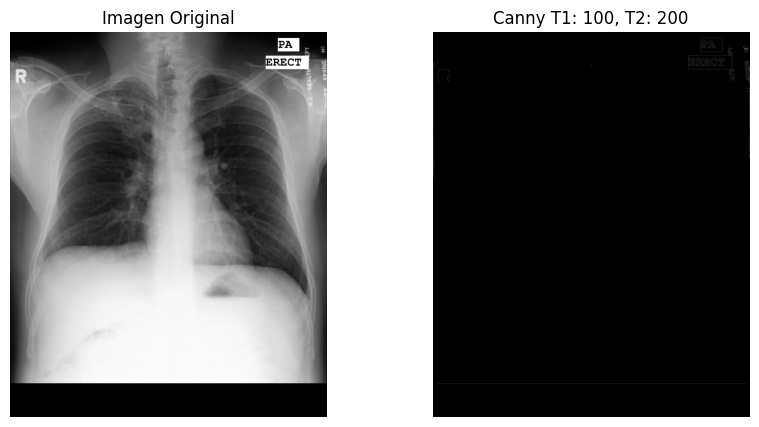

In [53]:
def sobel_edge_detection(image, direction='combined', ksize=3):
    """
    Aplica el filtro Sobel para detección de bordes con hiperparametrización.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        direction (str): Dirección del gradiente ('x', 'y', o 'combined').
        ksize (int): Tamaño del kernel Sobel (debe ser 1, 3, 5 o 7).

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Asegurarse de que la imagen está en float32
    image = np.float32(image)

    # Aplicar Sobel
    sobel_x = cv2.Sobel(image, cv2.CV_32F, 1, 0, ksize=ksize)
    sobel_y = cv2.Sobel(image, cv2.CV_32F, 0, 1, ksize=ksize)

    if direction == 'x':
        gradient = np.abs(sobel_x)
    elif direction == 'y':
        gradient = np.abs(sobel_y)
    else:
        gradient = np.sqrt(sobel_x**2 + sobel_y**2)

    # Normalizar a rango 0-255
    gradient = np.uint8(np.clip(gradient, 0, 255))

    # Mejorar el contraste
    gradient = cv2.equalizeHist(gradient)

    return gradient

def canny_edge_detection(imagen, threshold1=50, threshold2=150):
    """
    Aplica el filtro Canny para detección de bordes con hiperparametrización.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        threshold1 (int): Umbral inferior para la detección de bordes.
        threshold2 (int): Umbral superior para la detección de bordes.

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Asegurar que la imagen está en el formato correcto
    if imagen.dtype != np.uint8:
        imagen = np.uint8(cv2.normalize(imagen, None, 0, 255, cv2.NORM_MINMAX))

    # 1. Preprocesamiento
    # Reducción de ruido con filtro bilateral
    imagen_filtrada = cv2.bilateralFilter(imagen, d=9, sigmaColor=75, sigmaSpace=75)

    # 2. Mejora de contraste
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    imagen_mejorada = clahe.apply(imagen_filtrada)

    # 3. Detección de bordes
    bordes = cv2.Canny(imagen_mejorada, threshold1=threshold1, threshold2=threshold2)

    # 4. Post-procesamiento
    kernel = np.ones((3, 3), np.uint8)
    bordes_dilatados = cv2.dilate(bordes, kernel, iterations=1)
    bordes_finales = cv2.erode(bordes_dilatados, kernel, iterations=1)

    return bordes_finales

def visualize_canny_hyperparameter_search(imagen, thresholds):
    """
    Realiza la hiperparametrización del filtro Canny y visualiza los resultados.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        thresholds (list of tuple): Lista de pares de umbrales (threshold1, threshold2) a probar.
    """
    for threshold1, threshold2 in thresholds:
        # Aplicar filtro Canny
        result = canny_edge_detection(imagen, threshold1=threshold1, threshold2=threshold2)

        # Visualizar imagen original y resultado
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(imagen, cmap='gray')
        plt.title("Imagen Original")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(result, cmap='gray')
        plt.title(f"Canny T1: {threshold1}, T2: {threshold2}")
        plt.axis('off')

        plt.show()

# Definir parámetros para Canny
thresholds_canny = [(2, 5), (5, 10), (10, 20), (15, 25), (20, 40), (50, 100), (100, 200)]

# Realizar búsqueda de hiperparámetros para Canny
visualize_canny_hyperparameter_search(image, thresholds_canny)


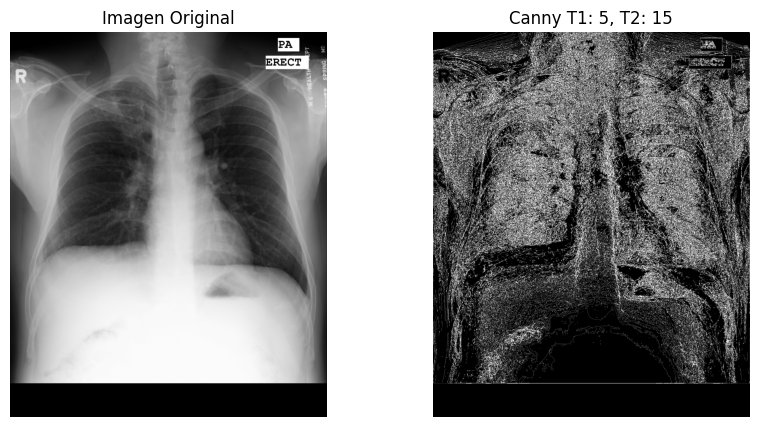

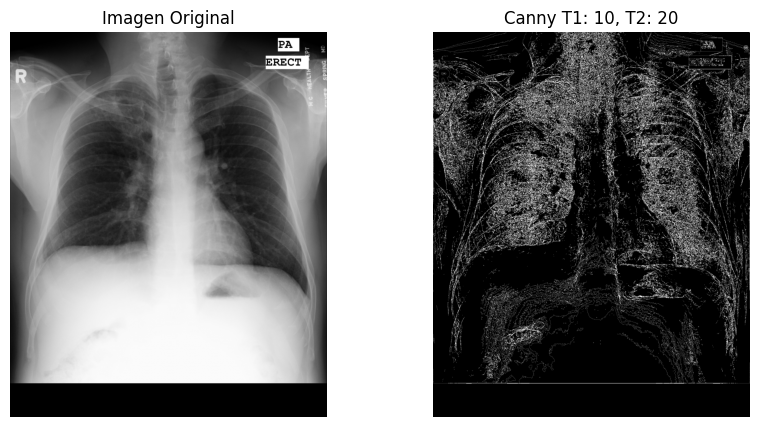

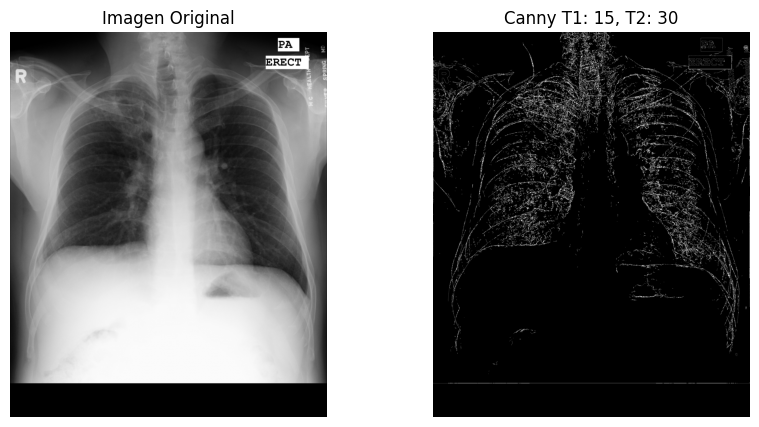

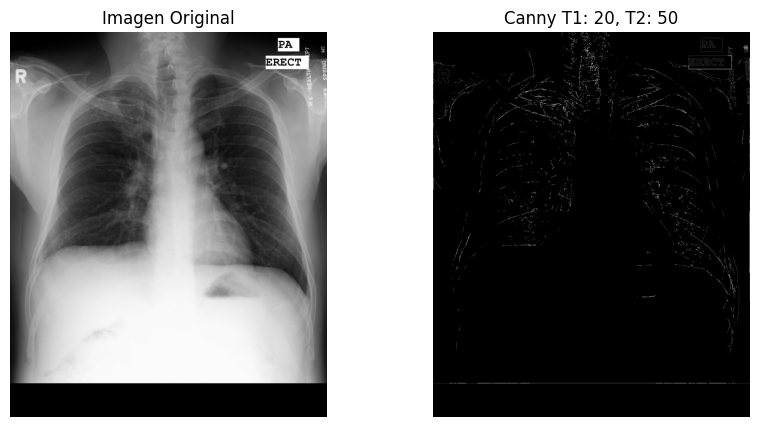

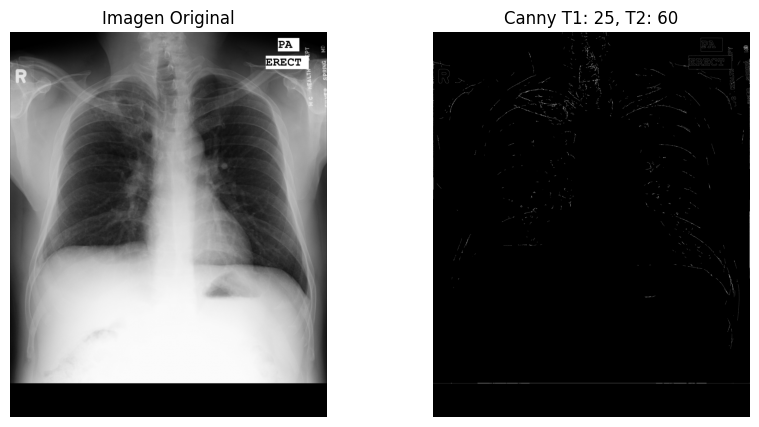

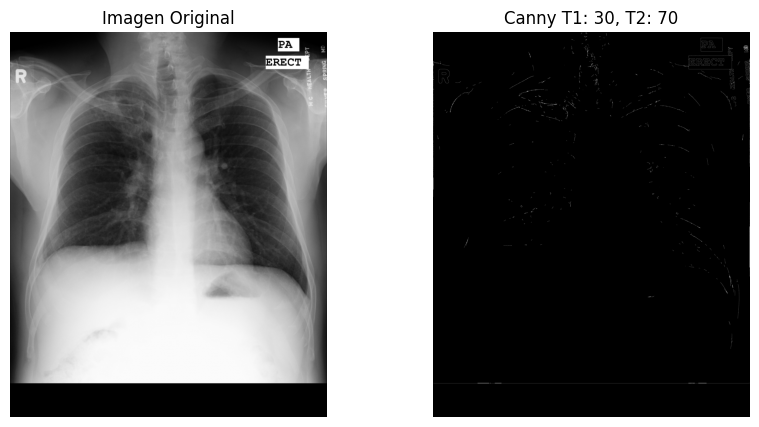

In [54]:
# Definir nuevos parámetros refinados para Canny
refined_thresholds_canny = [(5, 15), (10, 20), (15, 30), (20, 50), (25, 60), (30, 70)]

# Realizar búsqueda de hiperparámetros para Canny con los valores refinados
visualize_canny_hyperparameter_search(image, refined_thresholds_canny)

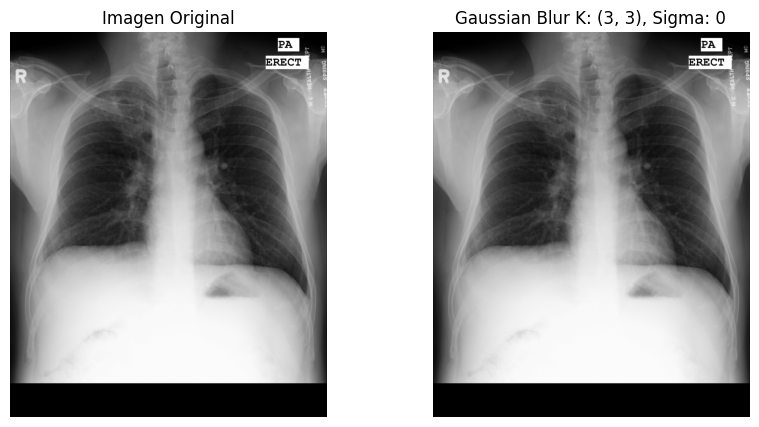

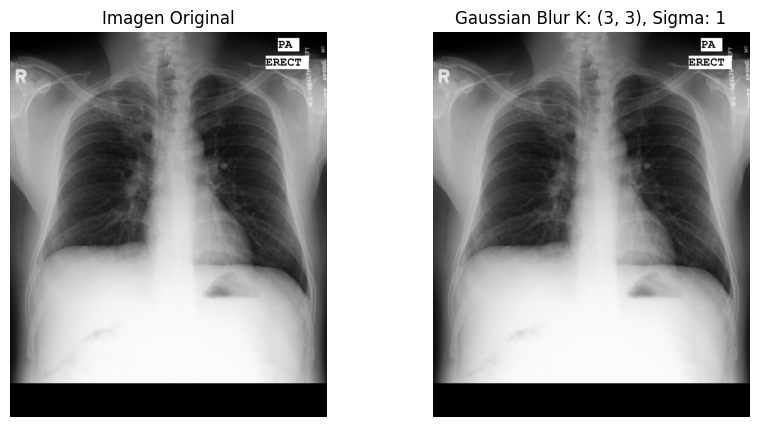

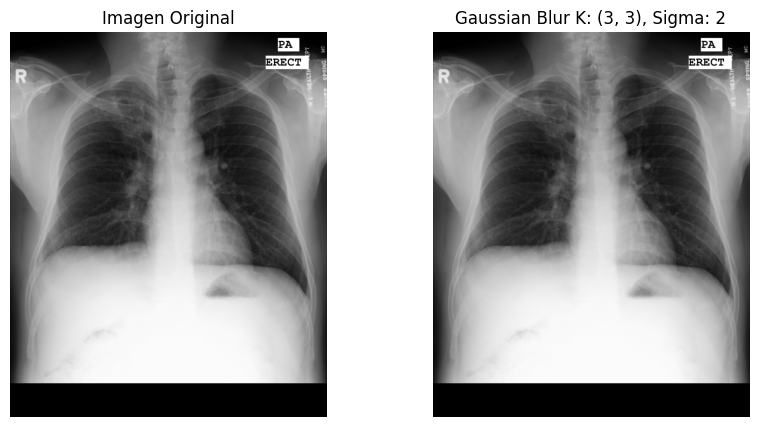

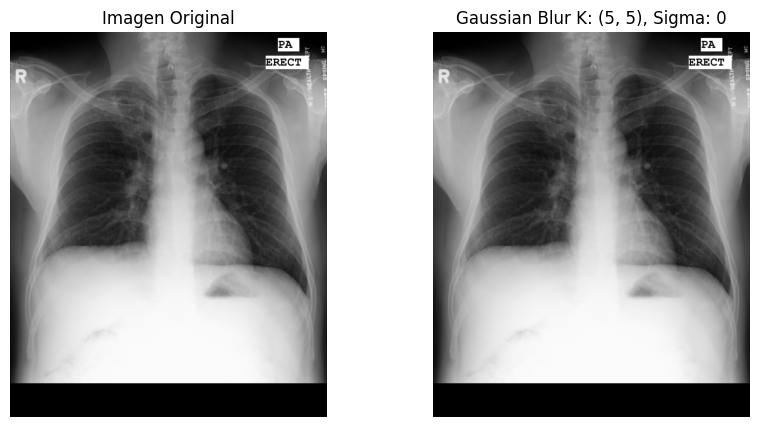

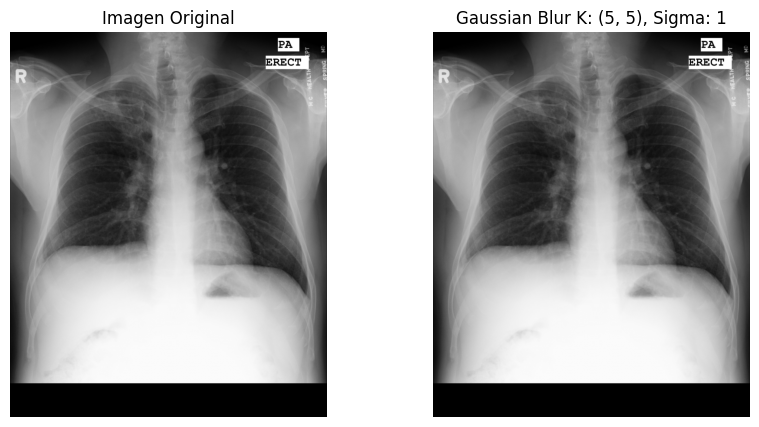

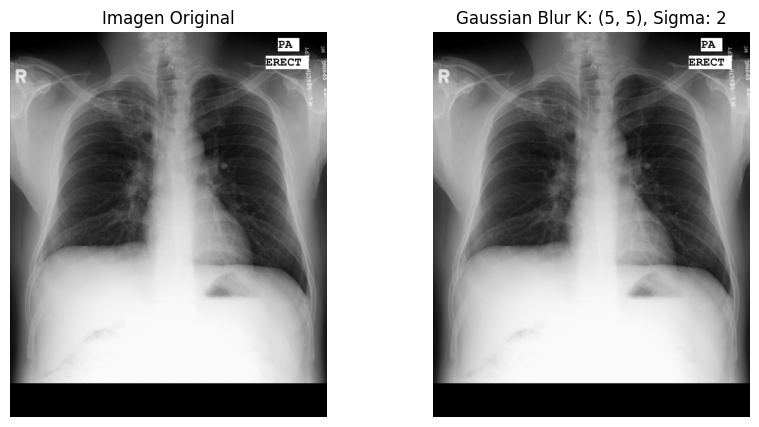

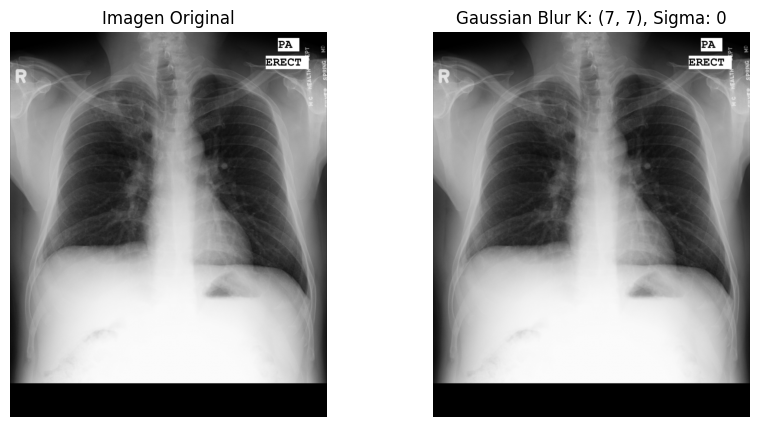

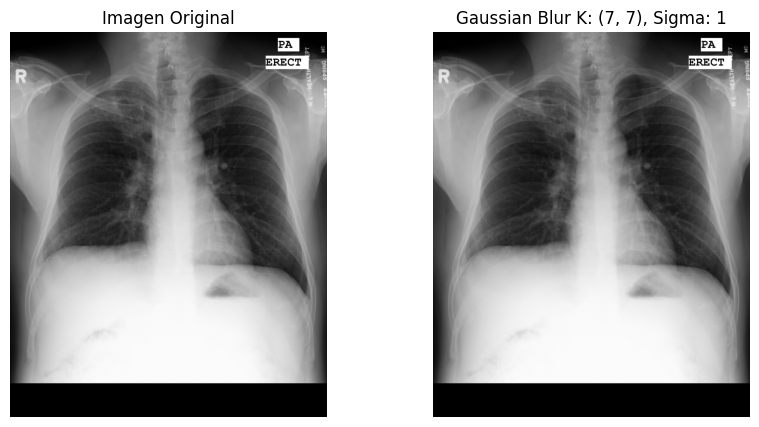

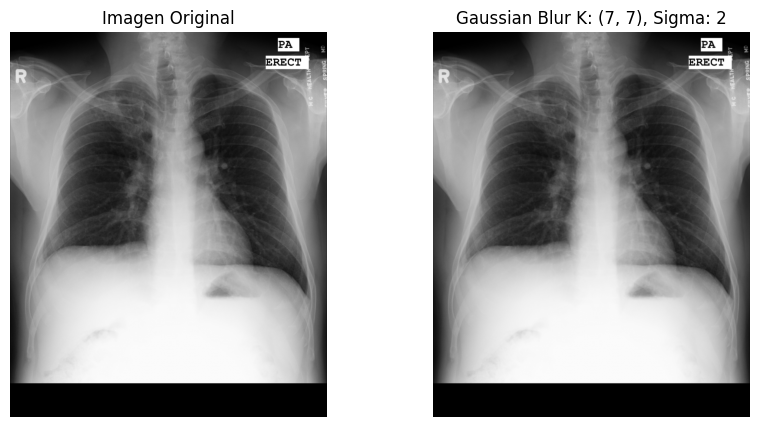

In [55]:
def gaussian_blur_filter(imagen, kernel_size=(5, 5), sigmaX=0):
    """
    Aplica el filtro Gaussian Blur para reducción de ruido.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        kernel_size (tuple): Tamaño del kernel.
        sigmaX (float): Desviación estándar en el eje X.

    Returns:
        numpy.ndarray: Imagen filtrada con Gaussian Blur.
    """
    return cv2.GaussianBlur(imagen, kernel_size, sigmaX)

def visualize_gaussian_hyperparameter_search(imagen, kernel_sizes, sigma_values):
    """
    Realiza la hiperparametrización del filtro Gaussian Blur y visualiza los resultados.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        kernel_sizes (list of tuple): Lista de tamaños de kernel a probar.
        sigma_values (list of float): Lista de valores de sigmaX a probar.
    """
    for kernel_size in kernel_sizes:
        for sigmaX in sigma_values:
            # Aplicar filtro Gaussian Blur
            result = gaussian_blur_filter(imagen, kernel_size=kernel_size, sigmaX=sigmaX)

            # Visualizar imagen original y resultado
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(imagen, cmap='gray')
            plt.title("Imagen Original")
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(result, cmap='gray')
            plt.title(f"Gaussian Blur K: {kernel_size}, Sigma: {sigmaX}")
            plt.axis('off')

            plt.show()

# Definir parámetros para Gaussian Blur
kernel_sizes_gaussian = [(3, 3), (5, 5), (7, 7)]
sigma_values_gaussian = [0, 1, 2]

# Realizar búsqueda de hiperparámetros para Gaussian Blur
visualize_gaussian_hyperparameter_search(image, kernel_sizes_gaussian, sigma_values_gaussian)


<h3>¿Por qué apenas hay diferencia entre estas imágenes?</h3>
<p>Esto es debido a que las imágenes originales se encuentran bien enfocadas y este filtro está más orientado al enfoque de las imágenes, por tanto, parece que apenas hace cambios este filtro. </p>

<h1>HIPERPARAMETRIZACIÓN CON NUEVAS TÉCNICAS O FILTROS</h1>

<h2>Filtro de mediana</h2>

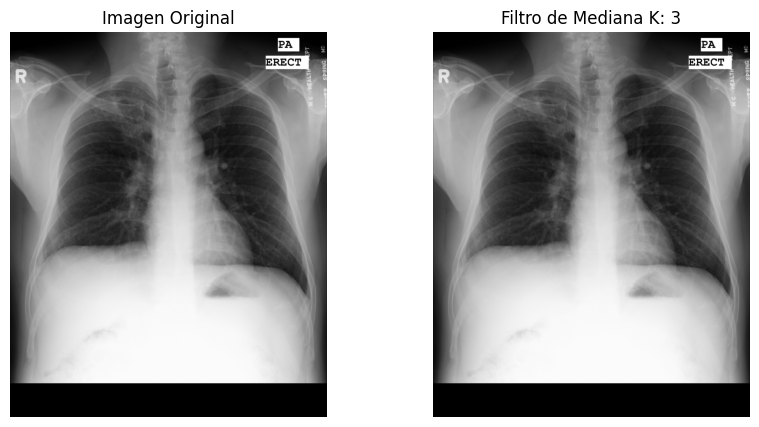

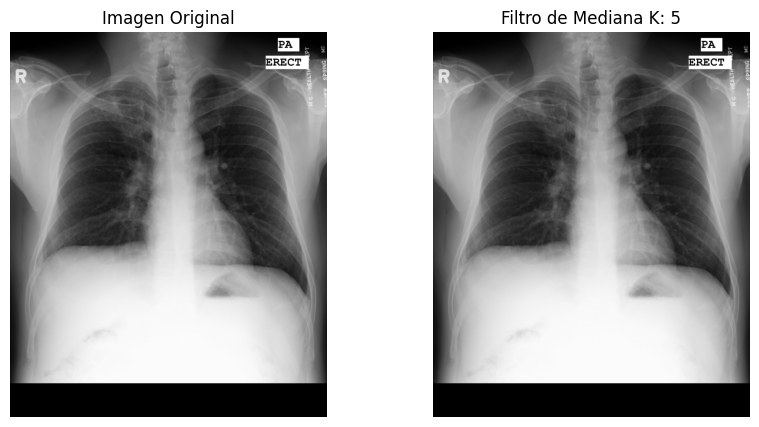

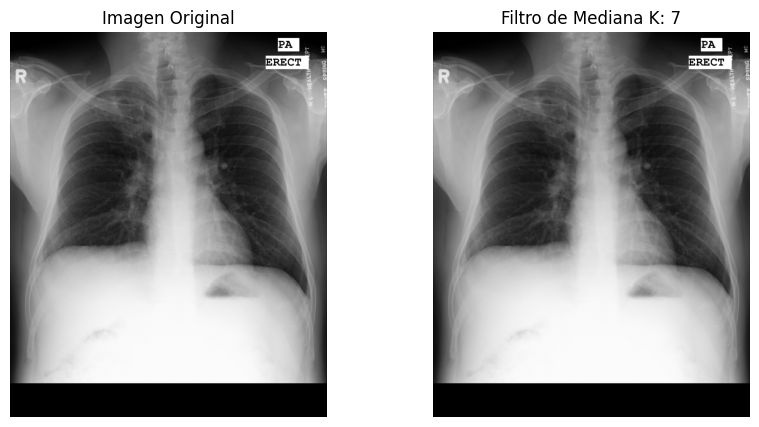

In [56]:
def median_filter(imagen, kernel_size=3):
    """
    Aplica el filtro de Mediana para reducción de ruido.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        kernel_size (int): Tamaño del kernel (debe ser impar).

    Returns:
        numpy.ndarray: Imagen filtrada con el filtro de Mediana.
    """
    return cv2.medianBlur(imagen, kernel_size)

def visualize_median_hyperparameter_search(imagen, kernel_sizes):
    """
    Realiza la hiperparametrización del filtro de Mediana y visualiza los resultados.

    Args:
        imagen (numpy.ndarray): Imagen de entrada.
        kernel_sizes (list of int): Lista de tamaños de kernel a probar.
    """
    for kernel_size in kernel_sizes:
        # Aplicar filtro de Mediana
        result = median_filter(imagen, kernel_size=kernel_size)

        # Visualizar imagen original y resultado
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(imagen, cmap='gray')
        plt.title("Imagen Original")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(result, cmap='gray')
        plt.title(f"Filtro de Mediana K: {kernel_size}")
        plt.axis('off')

        plt.show()

# Definir parámetros para el filtro de Mediana
kernel_sizes_median = [3, 5, 7]

# Realizar búsqueda de hiperparámetros para el filtro de Mediana
visualize_median_hyperparameter_search(image, kernel_sizes_median)


<h2>Filtro Wiener</h2>

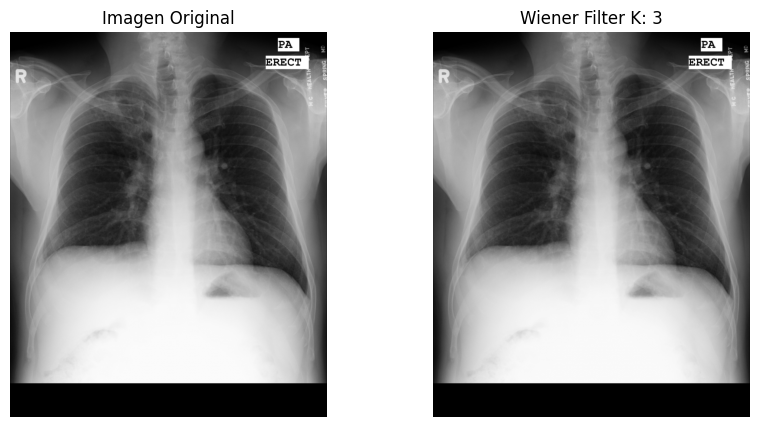

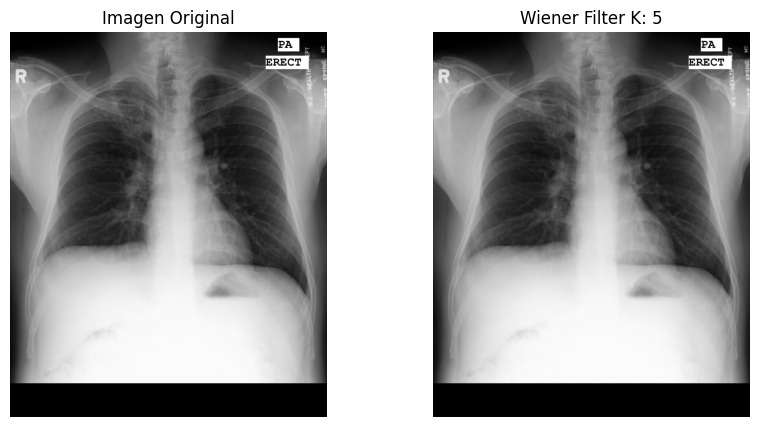

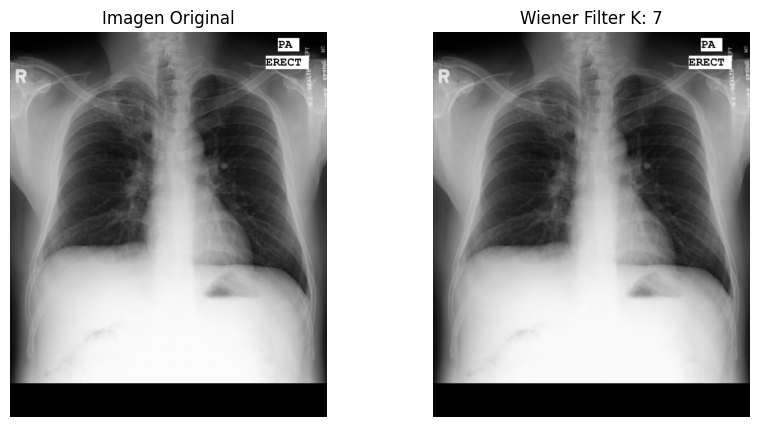

In [57]:
def wiener_filter(image, kernel_size=3):
    """
    Aplica el filtro Wiener para reducción de desenfoque y ruido en la imagen.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_size (int): Tamaño del kernel (debe ser impar).

    Returns:
        numpy.ndarray: Imagen filtrada con el filtro Wiener.
    """
    from scipy.signal import convolve2d

    # Crear kernel uniforme
    kernel = np.ones((kernel_size, kernel_size)) / (kernel_size ** 2)

    # Calcular la media local
    local_mean = convolve2d(image, kernel, boundary='symm', mode='same')

    # Calcular la varianza local
    local_var = convolve2d(image ** 2, kernel, boundary='symm', mode='same') - local_mean ** 2

    # Evitar divisiones por cero
    local_var[local_var < 1e-10] = 1e-10

    # Varianza del ruido (se puede ajustar según los datos)
    noise_var = np.mean(local_var[local_var > 1e-10])  # Considerar solo valores válidos

    # Aplicar el filtro Wiener
    result = local_mean + (np.maximum(0, local_var - noise_var) / (local_var + 1e-10)) * (image - local_mean)

    # Normalizar para visualización
    result = cv2.normalize(result, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    return result

def visualize_wiener_hyperparameter_search(image, kernel_sizes):
    """
    Realiza la hiperparametrización del filtro Wiener y visualiza los resultados.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        kernel_sizes (list of int): Lista de tamaños de kernel a probar.
    """
    for kernel_size in kernel_sizes:
        # Aplicar filtro Wiener
        result = wiener_filter(image, kernel_size=kernel_size)

        # Visualizar imagen original y resultado
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(image, cmap='gray')
        plt.title("Imagen Original")
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(result, cmap='gray')
        plt.title(f"Wiener Filter K: {kernel_size}")
        plt.axis('off')

        plt.show()

# Definir parámetros para el filtro Wiener
kernel_sizes_wiener = [3, 5, 7]

# Realizar búsqueda de hiperparámetros para el filtro Wiener
visualize_wiener_hyperparameter_search(image, kernel_sizes_wiener)


<h2>FILTRO SCHARR</h2>

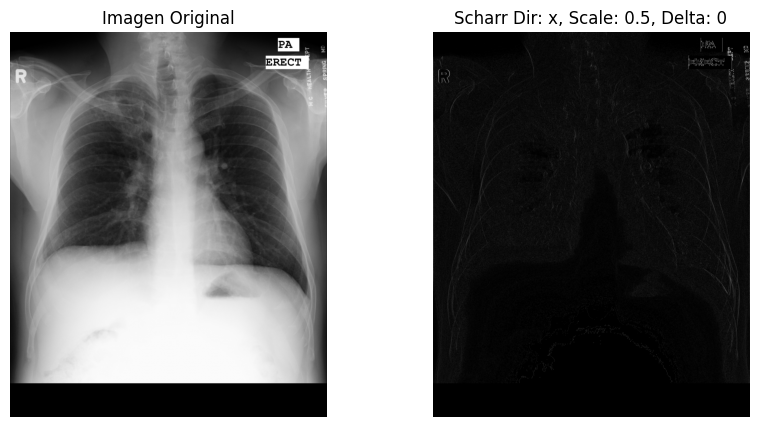

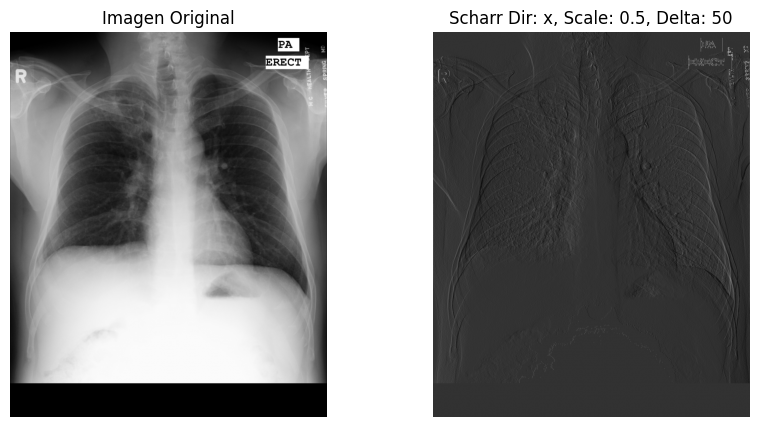

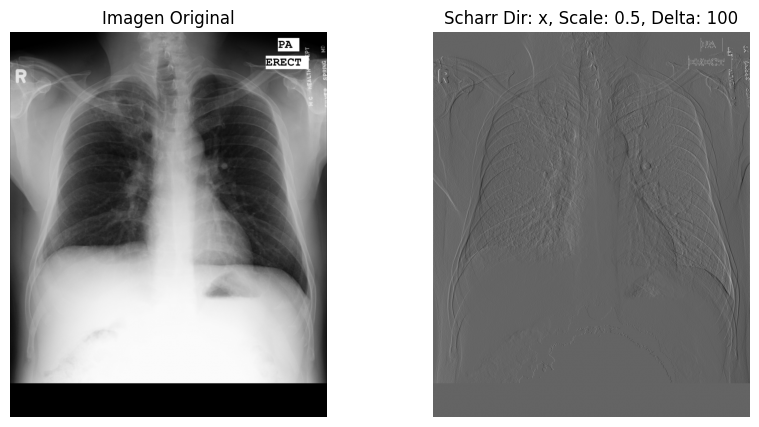

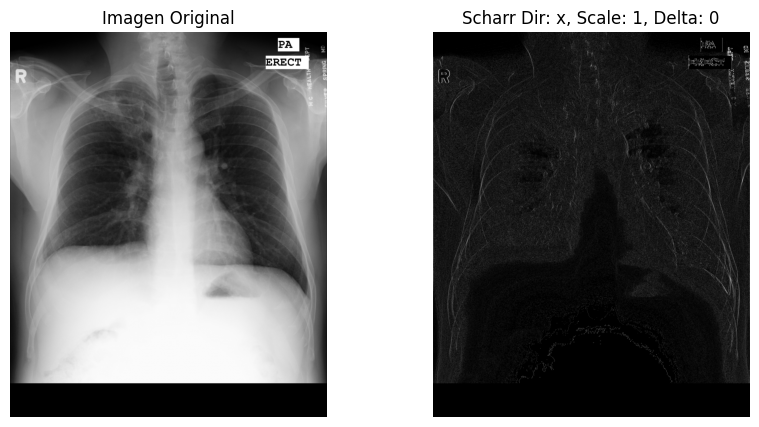

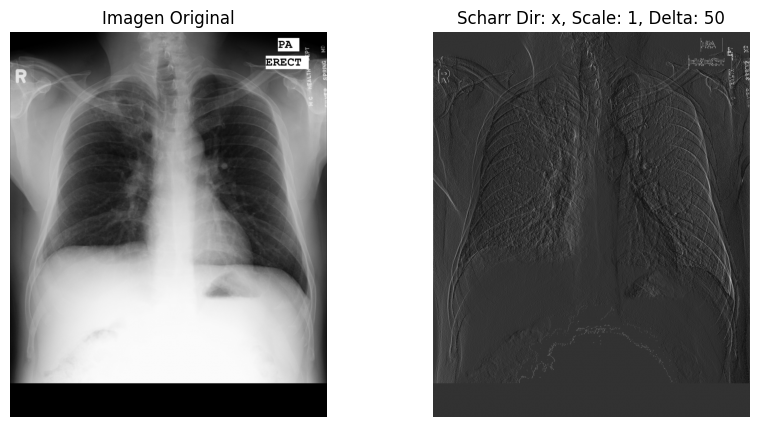

...

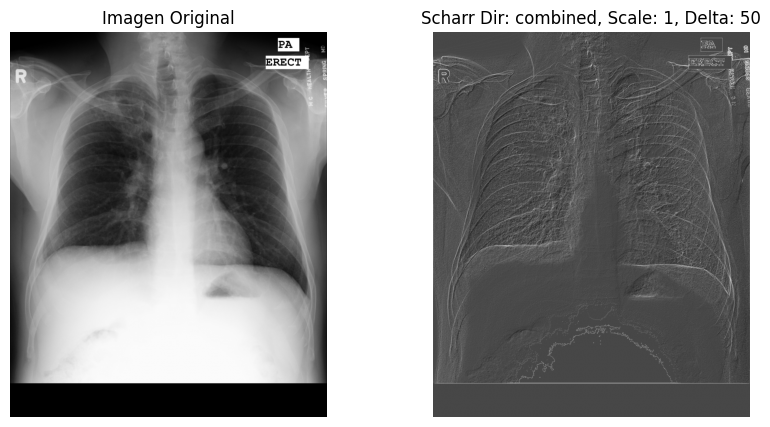

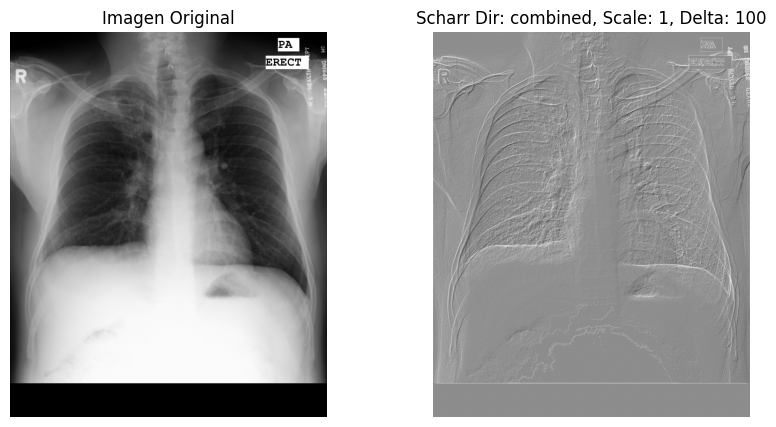

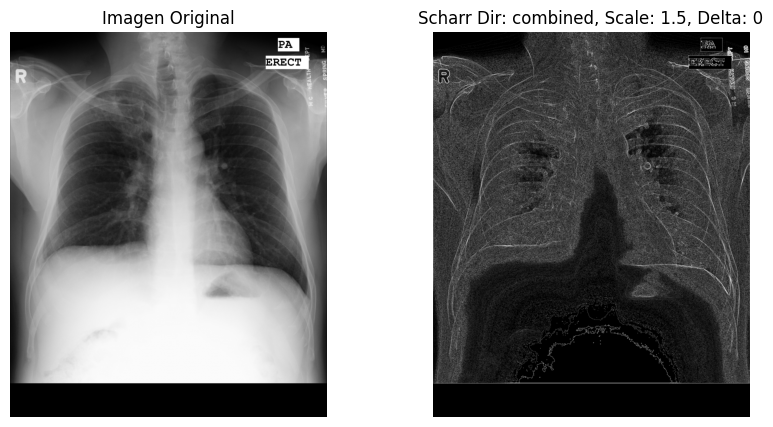

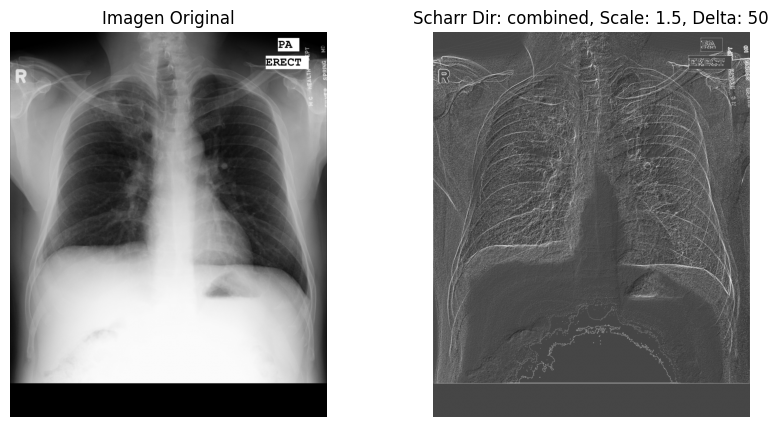

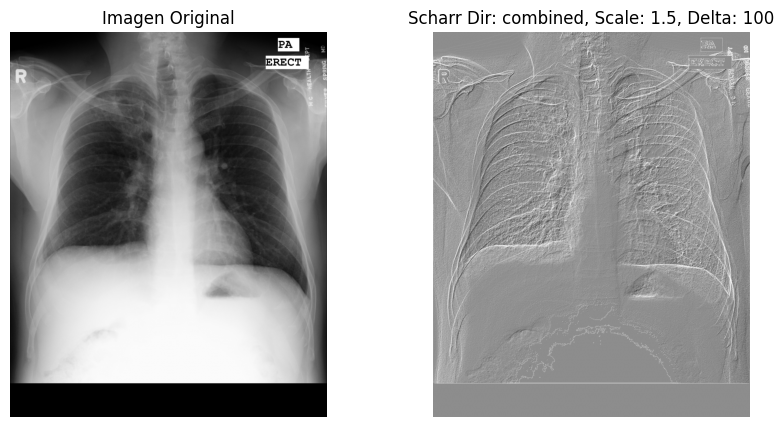

In [65]:
def preprocess_image(image):
    """
    Preprocesa la imagen mediante ecualización del histograma para mejorar la distribución de intensidades.

    Args:
        image (numpy.ndarray): Imagen de entrada.

    Returns:
        numpy.ndarray: Imagen preprocesada.
    """
    # Convertir a escala de grises si es necesario
    if len(image.shape) == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Normalizar imagen si no está en rango [0, 255]
    if image.dtype != np.uint8:
        image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Aplicar ecualización de histograma
    image_eq = cv2.equalizeHist(image)

    return image_eq

def apply_scharr(image, direction='combined', scale=1, delta=0):
    """
    Aplica el filtro Scharr para detección de bordes con parámetros ajustables.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        direction (str): Dirección del gradiente ('x', 'y', o 'combined').
        scale (float): Factor de escala para el gradiente calculado.
        delta (float): Valor agregado al resultado después de escalarlo.

    Returns:
        numpy.ndarray: Imagen con bordes detectados.
    """
    # Convertir a escala de grises si es necesario
    if len(image.shape) == 3:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Aplicar filtro Scharr en las direcciones x e y
    scharr_x = cv2.Scharr(image, cv2.CV_64F, 1, 0) * scale + delta
    scharr_y = cv2.Scharr(image, cv2.CV_64F, 0, 1) * scale + delta

    if direction == 'x':
        result = cv2.convertScaleAbs(scharr_x)
    elif direction == 'y':
        result = cv2.convertScaleAbs(scharr_y)
    else:
        combined = cv2.magnitude(scharr_x, scharr_y)
        result = cv2.convertScaleAbs(combined)

    return result

def hyperparameterize_scharr(image, directions, scales, deltas):
    """
    Realiza la hiperparametrización del filtro Scharr para diferentes combinaciones de parámetros.

    Args:
        image (numpy.ndarray): Imagen de entrada.
        directions (list of str): Lista de direcciones a probar ('x', 'y', 'combined').
        scales (list of float): Lista de factores de escala a probar.
        deltas (list of float): Lista de valores delta a probar.
    """
    # Preprocesar la imagen
    image_preprocessed = preprocess_image(image)

    for direction in directions:
        for scale in scales:
            for delta in deltas:
                # Aplicar filtro Scharr
                scharr_result = apply_scharr(image_preprocessed, direction=direction, scale=scale, delta=delta)

                # Visualizar resultados
                plt.figure(figsize=(10, 5))

                # Imagen original
                plt.subplot(1, 2, 1)
                plt.imshow(image, cmap='gray')
                plt.title("Imagen Original")
                plt.axis('off')

                # Resultado Scharr
                plt.subplot(1, 2, 2)
                plt.imshow(scharr_result, cmap='gray')
                plt.title(f"Scharr Dir: {direction}, Scale: {scale}, Delta: {delta}")
                plt.axis('off')

                plt.show()

# Definir parámetros para la hiperparametrización del filtro Scharr
directions_scharr = ['x', 'y', 'combined']
scales_scharr = [0.5, 1, 1.5]
deltas_scharr = [0, 50, 100]

# Realizar la hiperparametrización
hyperparameterize_scharr(image, directions_scharr, scales_scharr, deltas_scharr)


Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0383_1.png


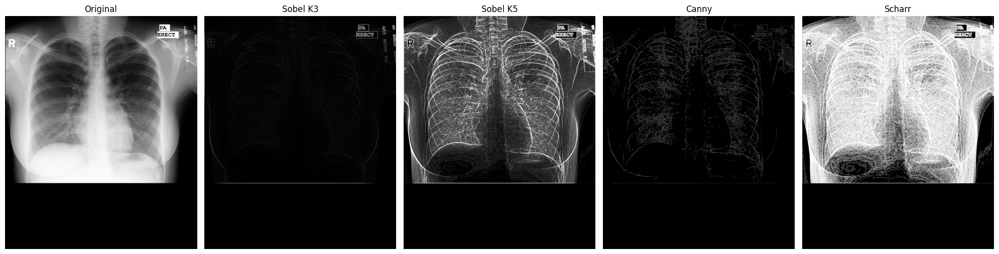

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0367_1.png


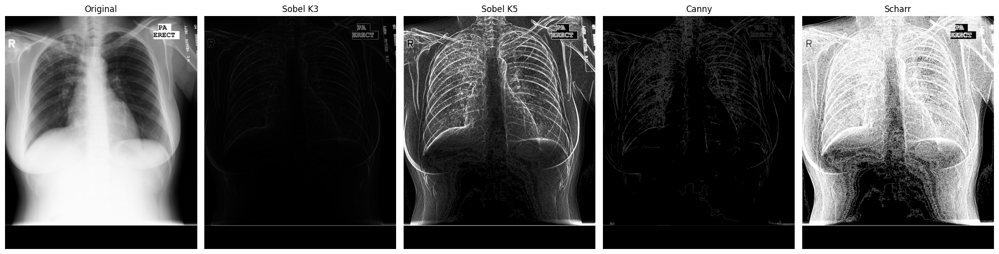

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0338_1.png


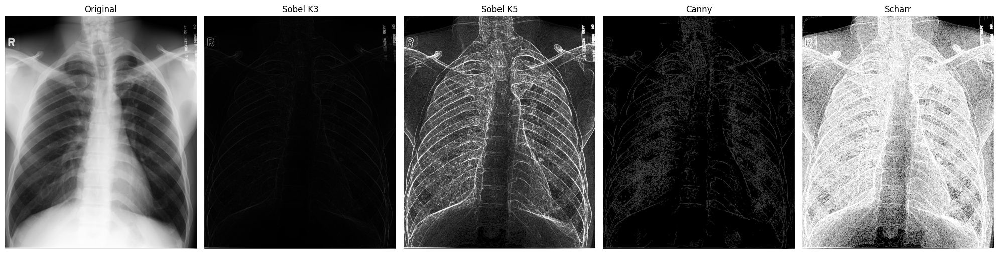

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0266_1.png


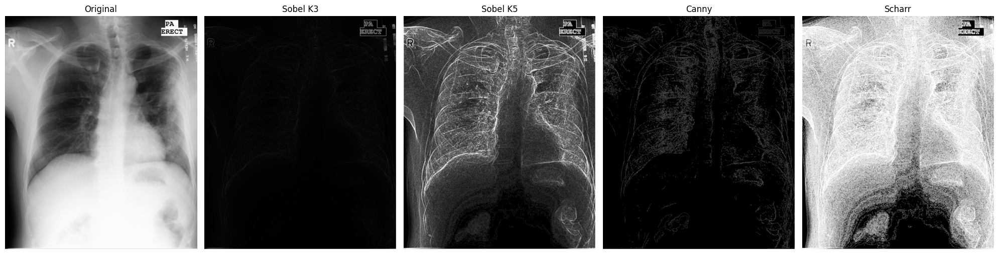

In [70]:
def display_pipeline_results(image_path):
    """
    Aplica un pipeline de filtros (Sobel, Canny y Scharr) a una imagen y muestra los resultados.

    Args:
        image_path (str): Ruta de la imagen a procesar.
    """
    # Cargar imagen
    image = load_image(image_path)

    # Preprocesamiento
    blurred = gaussian_blur(image)
    wiener = wiener_filter(blurred)

    # Aplicar filtros
    sobel_3 = sobel_edge_detection(wiener, direction='combined', ksize=3)
    sobel_5 = sobel_edge_detection(wiener, direction='combined', ksize=5)  
    canny = canny_edge_detection(wiener, threshold1=15, threshold2=25)
    scharr = apply_scharr(wiener, direction='combined', scale=15, delta=0)

    # Mostrar resultados
    plt.figure(figsize=(20, 10))

    # Imagen original
    plt.subplot(1, 5, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original")
    plt.axis('off')

    # Sobel kernel 3
    plt.subplot(1, 5, 2)
    plt.imshow(sobel_3, cmap='gray')
    plt.title("Sobel K3")
    plt.axis('off')

    # Sobel kernel 5
    plt.subplot(1, 5, 3)
    plt.imshow(sobel_5, cmap='gray')
    plt.title("Sobel K5")
    plt.axis('off')

    # Canny
    plt.subplot(1, 5, 4)
    plt.imshow(canny, cmap='gray')
    plt.title("Canny")
    plt.axis('off')

    # Scharr
    plt.subplot(1, 5, 5)
    plt.imshow(scharr, cmap='gray')
    plt.title("Scharr")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def apply_pipeline_to_images(image_paths):
    """
    Aplica el pipeline a una lista de imágenes.

    Args:
        image_paths (list): Lista de rutas de las imágenes.
    """
    for image_path in image_paths:
        print(f"Procesando imagen: {image_path}")
        display_pipeline_results(image_path)

# Aplicar pipeline a las imágenes seleccionadas
apply_pipeline_to_images(selected_image_paths)


<h1>PIPELINE SIN PREPROCESADO (peores en todos los casos)</h1>

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0383_1.png


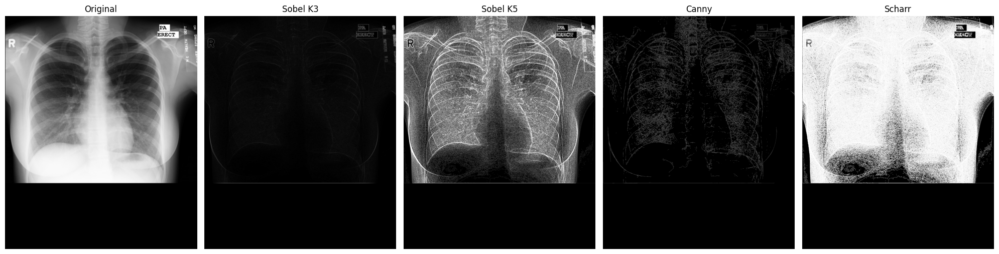

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0367_1.png


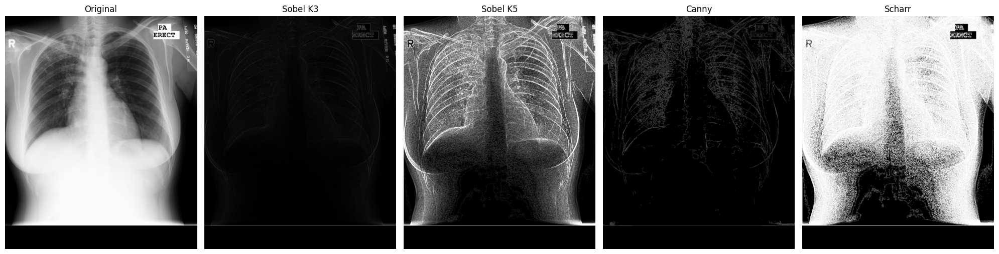

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0338_1.png


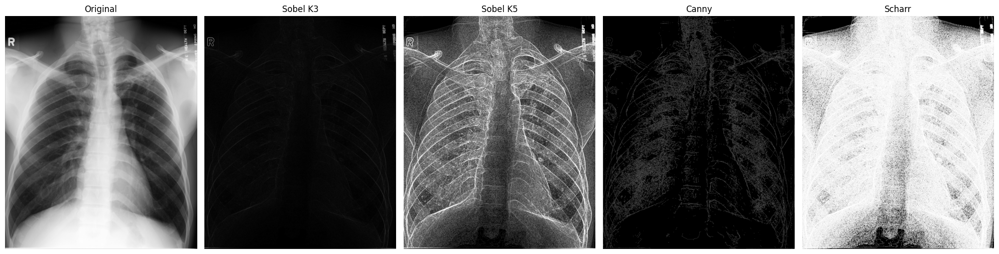

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0266_1.png


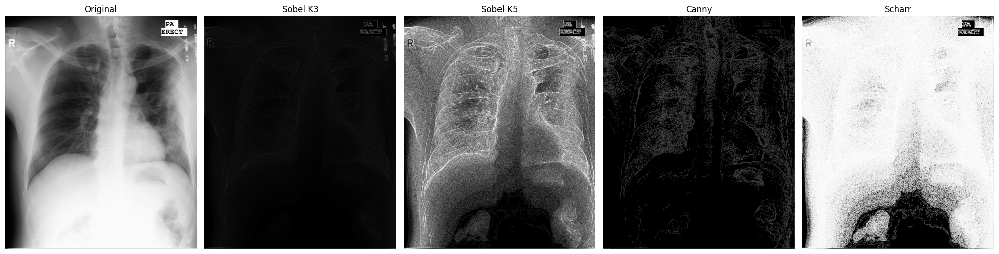

In [72]:
def display_pipeline_results(image_path):
    """
    Aplica un pipeline de filtros (Sobel, Canny y Scharr) a una imagen y muestra los resultados.

    Args:
        image_path (str): Ruta de la imagen a procesar.
    """
    # Cargar imagen
    image = load_image(image_path)

    # Aplicar filtros
    sobel_3 = sobel_edge_detection(image, direction='combined', ksize=3)
    sobel_5 = sobel_edge_detection(image, direction='combined', ksize=5)  
    canny = canny_edge_detection(image, threshold1=15, threshold2=25)
    scharr = apply_scharr(image, direction='combined', scale=15, delta=0)

    # Mostrar resultados
    plt.figure(figsize=(20, 10))

    # Imagen original
    plt.subplot(1, 5, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original")
    plt.axis('off')

    # Sobel kernel 3
    plt.subplot(1, 5, 2)
    plt.imshow(sobel_3, cmap='gray')
    plt.title("Sobel K3")
    plt.axis('off')

    # Sobel kernel 5
    plt.subplot(1, 5, 3)
    plt.imshow(sobel_5, cmap='gray')
    plt.title("Sobel K5")
    plt.axis('off')

    # Canny
    plt.subplot(1, 5, 4)
    plt.imshow(canny, cmap='gray')
    plt.title("Canny")
    plt.axis('off')

    # Scharr
    plt.subplot(1, 5, 5)
    plt.imshow(scharr, cmap='gray')
    plt.title("Scharr")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def apply_pipeline_to_images(image_paths):
    """
    Aplica el pipeline a una lista de imágenes.

    Args:
        image_paths (list): Lista de rutas de las imágenes.
    """
    for image_path in image_paths:
        print(f"Procesando imagen: {image_path}")
        display_pipeline_results(image_path)

# Aplicar pipeline a las imágenes seleccionadas
apply_pipeline_to_images(selected_image_paths)


<h1>PIPELINE MEJORADO</h1>

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0383_1.png


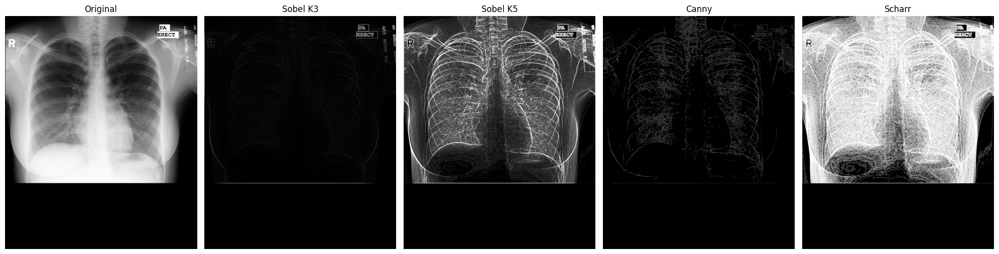

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0367_1.png


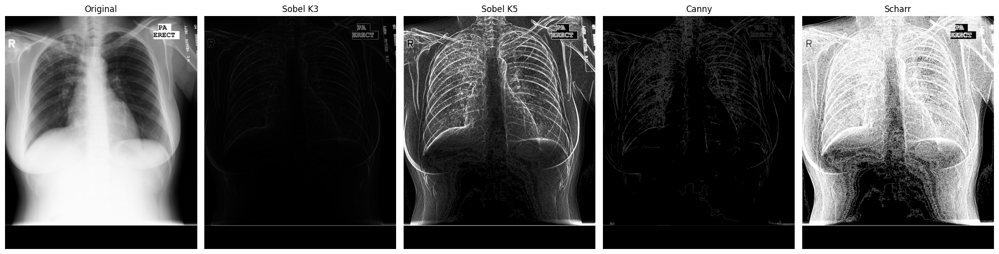

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0338_1.png


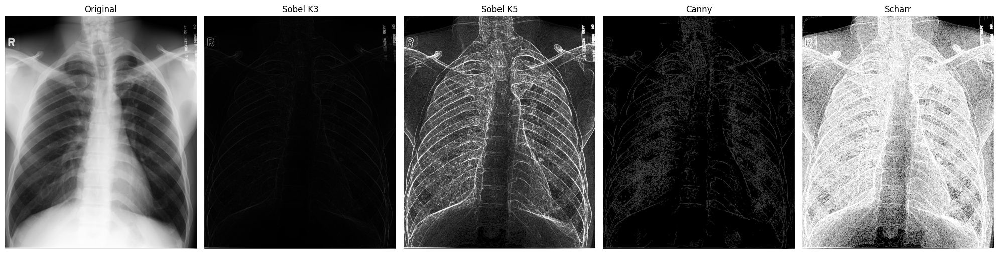

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0266_1.png


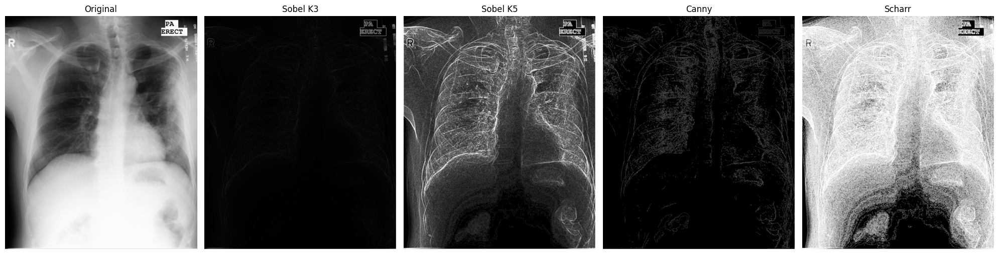

In [73]:
def display_pipeline_results(image_path):
    """
    Aplica un pipeline de filtros (Sobel, Canny y Scharr) a una imagen y muestra los resultados.

    Args:
        image_path (str): Ruta de la imagen a procesar.
    """
    # Cargar imagen
    image = load_image(image_path)

    # Preprocesamiento
    blurred = gaussian_blur(image)
    wiener = wiener_filter(blurred)

    # Aplicar filtros
    sobel_3 = sobel_edge_detection(wiener, direction='combined', ksize=3)
    sobel_5 = sobel_edge_detection(wiener, direction='combined', ksize=5)  # Cambiado de 4 a 5 para cumplir con restricciones de OpenCV
    canny = canny_edge_detection(wiener, threshold1=15, threshold2=25)
    scharr = apply_scharr(wiener, direction='combined', scale=15, delta=0)

    # Mostrar resultados
    plt.figure(figsize=(20, 10))

    # Imagen original
    plt.subplot(1, 5, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original")
    plt.axis('off')

    # Sobel kernel 3
    plt.subplot(1, 5, 2)
    plt.imshow(sobel_3, cmap='gray')
    plt.title("Sobel K3")
    plt.axis('off')

    # Sobel kernel 5
    plt.subplot(1, 5, 3)
    plt.imshow(sobel_5, cmap='gray')
    plt.title("Sobel K5")
    plt.axis('off')

    # Canny
    plt.subplot(1, 5, 4)
    plt.imshow(canny, cmap='gray')
    plt.title("Canny")
    plt.axis('off')

    # Scharr
    plt.subplot(1, 5, 5)
    plt.imshow(scharr, cmap='gray')
    plt.title("Scharr")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def apply_pipeline_to_images(image_paths):
    """
    Aplica el pipeline a una lista de imágenes.

    Args:
        image_paths (list): Lista de rutas de las imágenes.
    """
    for image_path in image_paths:
        print(f"Procesando imagen: {image_path}")
        display_pipeline_results(image_path)

# Aplicar pipeline a las imágenes seleccionadas
apply_pipeline_to_images(selected_image_paths)


Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0383_1.png


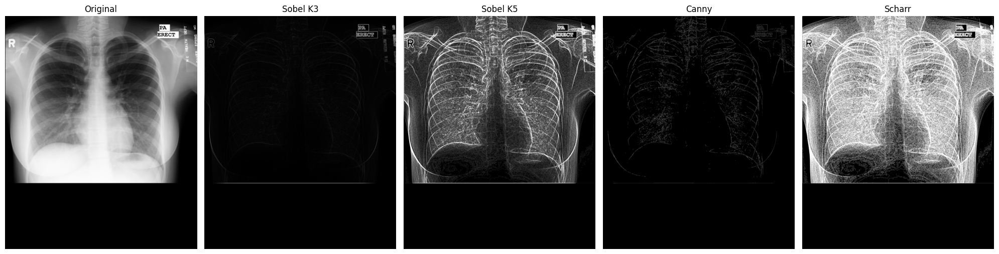

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0367_1.png


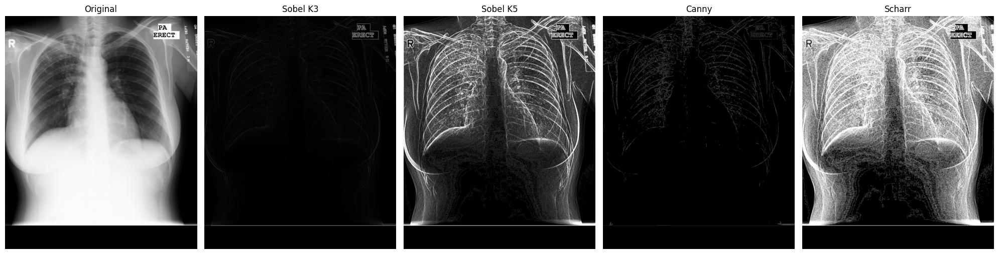

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0338_1.png


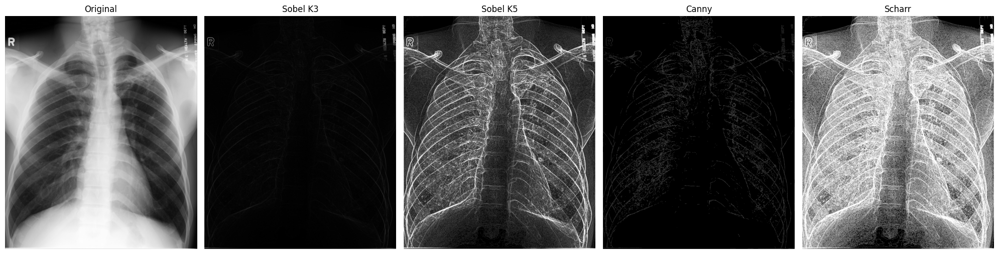

Procesando imagen: /Users/miguelangelnavarroarenas/.cache/kagglehub/datasets/raddar/tuberculosis-chest-xrays-montgomery/versions/1/images/images/MCUCXR_0266_1.png


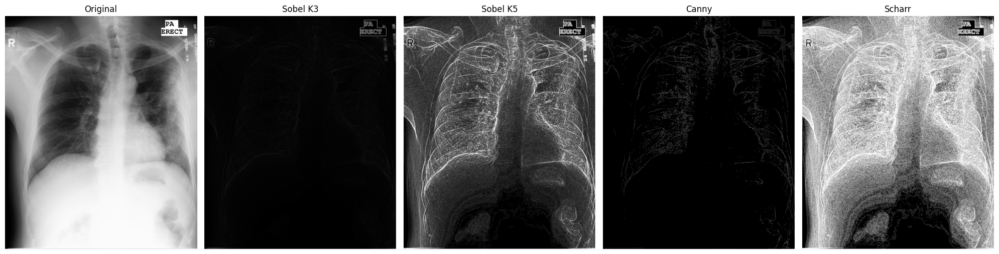

In [75]:
def display_pipeline_results(image_path):
    """
    Aplica un pipeline de filtros (Sobel, Canny y Scharr) a una imagen y muestra los resultados.

    Args:
        image_path (str): Ruta de la imagen a procesar.
    """
    # Cargar imagen
    image = load_image(image_path)

    # Preprocesamiento
    blurred = gaussian_blur(image)
    wiener = wiener_filter(blurred)

    # Aplicar filtros
    sobel_3 = sobel_edge_detection(wiener, direction='combined', ksize=3)
    sobel_5 = sobel_edge_detection(wiener, direction='combined', ksize=5)
    canny = canny_edge_detection(wiener, threshold1=20, threshold2=30)  # Ajustados los thresholds
    scharr = apply_scharr(wiener, direction='combined', scale=10, delta=5)  # Scale reducido y delta ajustado

    # Mostrar resultados
    plt.figure(figsize=(20, 10))

    # Imagen original
    plt.subplot(1, 5, 1)
    plt.imshow(image, cmap='gray')
    plt.title("Original")
    plt.axis('off')

    # Sobel kernel 3
    plt.subplot(1, 5, 2)
    plt.imshow(sobel_3, cmap='gray')
    plt.title("Sobel K3")
    plt.axis('off')

    # Sobel kernel 5
    plt.subplot(1, 5, 3)
    plt.imshow(sobel_5, cmap='gray')
    plt.title("Sobel K5")
    plt.axis('off')

    # Canny
    plt.subplot(1, 5, 4)
    plt.imshow(canny, cmap='gray')
    plt.title("Canny")
    plt.axis('off')

    # Scharr
    plt.subplot(1, 5, 5)
    plt.imshow(scharr, cmap='gray')
    plt.title("Scharr")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def apply_pipeline_to_images(image_paths):
    """
    Aplica el pipeline a una lista de imágenes.

    Args:
        image_paths (list): Lista de rutas de las imágenes.
    """
    for image_path in image_paths:
        print(f"Procesando imagen: {image_path}")
        display_pipeline_results(image_path)

# Aplicar pipeline a las imágenes seleccionadas
apply_pipeline_to_images(selected_image_paths)
